# TIME SERIES CLUSTERING<a id='home'></a> 

The aim of the projects is to develop a clustering algorithm for 811 time series 52 time steps long. Each of them represents the normalized sales of a specific product during one year. There are 811 product and the sales are collected over a year using one week as time step.

Time series clustering means assign each time series to a cluster. Similar objects should be put together and dissimilar object should be put faraway from each other. Clustering the products could be useful to understand which products sales affect the other products ones, in order to decide price or cross-selling strategies. Moreover cross predictions could be done over similar time series. This is an alternative way to do market basket analysis.

Here, we first implement a clustering algorithm for these time series and then, in order to evaluate the goodness of it, we will try to make predictions using same cluster objects. Let us make a list of the steps:

1. [Define an appropriate metric to characterize time series and create a distance matrix between time series;](#distance)
2. [Reduce the dimensionality of the matrix, in order to visualize the points, applying an appropriate algorithm (PCA or t-SNE);](#tsne)
3. [Represent the results and find the appropriate number (large scale clustering) of cluster using different algorithms and the silhouette index;](#firstclustering)
4. [Analyze each found cluster and apply a new clustering algorithm and find again the best number of cluster applying again silhouette index (small scale clustering);](#secondclustering)
5. [Testing the results computing the granger causality between same cluster series](#causa)
6. [Take one of the cluster, study the correlations between the time series inside it (the original not-normalized ones) and try to make prediction over them.](#forecasts)


Similar works could be find in:
1. "Time series clustering: A superior alternative for market basket analysis" by Tan, Swee Chuan and San Lau, Jess Pei. [1]
2. "Time series clustering based on the  characterisation of segment typologies" David Guijo-Rubio, Antonio Manuel Durán-Rosal, Pedro Antonio Gutiérrez, Senior Member, IEEE, Alicia Troncoso, and César Hervás-Martínez, Senior Member, IEEE. [2]

The latter also contains an useful description of various possible metrics and clustering algorithms.

In [36]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm



from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
from scipy.cluster.hierarchy import dendrogram
from dtaidistance import dtw
import warnings
warnings.filterwarnings('ignore')



# IMPORTING

In [3]:

df=pd.read_csv("Sales_Transactions_Dataset_Weekly.csv")
df

,Product_Code,W0,W1,W2,W3,W4,W5,W6,W7,W8,...,Normalized 42,Normalized 43,Normalized 44,Normalized 45,Normalized 46,Normalized 47,Normalized 48,Normalized 49,Normalized 50,Normalized 51
0,P1,11,12,10,8,13,12,14,21,6,...,0.06,0.22,0.28,0.39,0.50,0.00,0.22,0.17,0.11,0.39
1,P2,7,6,3,2,7,1,6,3,3,...,0.20,0.40,0.50,0.10,0.10,0.40,0.50,0.10,0.60,0.00
2,P3,7,11,8,9,10,8,7,13,12,...,0.27,1.00,0.18,0.18,0.36,0.45,1.00,0.45,0.45,0.36
3,P4,12,8,13,5,9,6,9,13,13,...,0.41,0.47,0.06,0.12,0.24,0.35,0.71,0.35,0.29,0.35
4,P5,8,5,13,11,6,7,9,14,9,...,0.27,0.53,0.27,0.60,0.20,0.20,0.13,0.53,0.33,0.40
5,P6,3,3,2,7,6,3,8,6,6,...,0.36,0.18,0.36,0.27,0.55,0.45,0.27,0.27,0.91,0.55
6,P7,4,8,3,7,8,7,2,3,10,...,0.20,0.30,0.30,0.60,0.20,0.60,0.20,0.40,0.20,0.10
7,P8,8,6,10,9,6,8,7,5,10,...,0.58,0.92,0.08,0.42,0.42,0.25,0.33,0.08,0.50,0.50
8,P9,14,9,10,7,11,15,12,7,13,...,0.53,0.13,0.67,0.00,0.27,0.27,0.47,0.60,0.27,0.67
9,P10,22,19,19,29,20,16,26,20,24,...,0.21,0.33,0.08,0.63,0.17,0.29,0.38,0.58,0.38,0.46


The dataframe contains two version of each time series. The first contains the effective number of sales in that week, whereas the second is the normalized (between 0 and 1) version of the first one. During the clustering implementation we will use the second version because we want to compare the behaviour of series that may have very different values.

In [4]:
a=np.array(df.iloc[:,55:110])
b=np.array(df.iloc[:,1:53])


## CHECKS

Check if there are missing values (no missing values)

In [0]:
np.mean(np.where(np.isnan(a), 1, 0))

0.0

Check if there are negative values (no negative values)

In [0]:
np.mean(np.where(a<0, 1, 0))

0.0

# [DISTANCES](#home) <a id='distance'></a> 

It was decided to use the dynamic time warping distance (DTW) that is considered the most accurated [2]. Each entry of the matrix represents the distance between the time series in the row and inthe column. Diagonal elements are set equal to zero.

In [0]:
ds = dtw.distance_matrix_fast(a)

In [0]:
for i in range(ds.shape[0]):
    ds[i][i]=0
for i in range(ds.shape[0]):
    for j in range(ds.shape[1]):
        ds[j][i]=ds[i][j]

In [0]:
pd.DataFrame(ds)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810
0,0.000000,1.235435,1.530033,1.114002,0.993831,1.324047,1.128893,1.161077,1.225724,1.143066,1.310992,1.039615,1.037834,1.041777,1.311564,1.165890,1.146647,1.157756,1.179407,1.186297,1.181736,1.211074,1.089862,1.278515,1.129026,1.203952,1.187645,1.150348,0.999500,1.388632,1.104129,1.244347,1.432620,1.301653,1.300961,0.966695,0.997447,0.944034,1.067193,1.254512,...,1.861693,1.317725,1.248599,1.266886,1.479054,1.774824,1.327742,1.474008,1.201416,1.467753,1.034650,1.468639,1.789525,1.567801,1.896523,1.711315,1.231219,1.233369,1.535090,1.437741,1.311907,1.315143,1.384774,1.334391,1.315865,1.196411,1.379420,1.592106,1.522301,1.548483,1.603527,1.164903,1.242135,1.261864,1.302037,1.600437,1.638261,1.561057,1.711082,1.596872
1,1.235435,0.000000,1.491509,1.095126,1.303764,1.310572,1.166190,1.330413,1.374009,1.265385,1.489698,1.191302,1.285963,1.369964,1.409468,1.225439,1.275304,1.134063,1.336413,1.372042,1.222457,1.242538,1.164259,1.296881,1.333454,1.499700,1.216470,1.283472,1.134592,1.313393,1.144640,1.239193,1.360588,1.190630,1.214743,1.262220,1.175500,1.309351,1.328796,1.370474,...,1.991206,1.679821,1.107429,1.421513,1.398320,1.691153,1.271456,1.837934,1.525877,1.668203,1.274049,1.707688,1.939072,1.729364,1.772005,1.854238,1.341641,1.311564,1.514166,1.586600,1.363818,1.713272,1.610900,1.538603,1.245512,1.317308,1.418274,1.758465,1.876326,1.691153,1.723630,1.282965,1.493486,1.365870,1.477396,1.752455,1.634350,1.802082,1.685230,1.609627
2,1.530033,1.491509,0.000000,1.370365,1.312631,1.364844,1.305756,1.310000,1.327177,1.268306,1.443537,1.369197,1.296457,1.402462,1.522958,1.427375,1.432899,1.373426,1.322989,1.498666,1.449379,1.384485,1.416051,1.446375,1.393449,1.556984,1.390396,1.353034,1.411630,1.478919,1.311716,1.407302,1.162110,1.415344,1.456537,1.479121,1.453926,1.544927,1.306828,1.457498,...,2.896032,1.634228,1.221393,1.589151,1.581202,1.581834,1.488859,2.113670,1.706751,1.732080,1.654751,1.671676,1.685527,1.743244,2.300500,2.087295,1.495059,1.545121,1.705462,1.536912,1.637406,1.971243,1.804134,1.667843,1.490000,1.537530,1.533167,2.035338,2.204745,1.943451,2.139556,1.411205,1.788351,1.570764,1.609223,2.002548,1.866307,1.999275,2.007262,2.188356
3,1.114002,1.095126,1.370365,0.000000,1.103630,1.079444,1.076104,1.281601,1.173243,1.119419,1.193524,1.098863,1.049857,1.206109,1.284445,1.139561,1.208718,1.103268,1.174181,1.308931,1.178983,1.226173,1.209049,1.294025,1.064002,1.175670,1.119821,1.180212,0.943769,1.386290,1.042641,1.187182,1.207228,1.345065,1.261071,1.059717,1.043312,1.136794,1.190336,1.382715,...,1.982196,1.299384,0.940213,1.319015,1.343019,1.456434,1.214208,1.527874,1.221843,1.335702,1.098954,1.368320,1.748857,1.515718,1.627022,1.661927,1.174351,1.147301,1.288953,1.473363,1.158706,1.386362,1.398142,1.359448,1.286351,1.183807,1.300500,1.511985,1.566397,1.598562,1.598280,1.040288,1.316397,1.228047,1.187224,1.607327,1.550581,1.679554,1.657408,1.475602
4,0.993831,1.303764,1.312631,1.103630,0.000000,1.094029,1.059103,1.086784,1.178474,1.038846,1.279219,1.077590,1.264674,1.006578,1.185200,1.120848,1.185791,1.299615,1.101998,1.332704,1.218113,1.062591,1.087290,1.309847,1.056598,1.208801,1.231990,1.169017,0.956086,1.454304,1.113373,1.332366,1.351518,1.265978,1.254432,0.974833,1.090092,1.090138,1.079444,1.295261,...,1.786673,1.208884,1.204824,1.182328,1.297189,1.615209,1.163744,1.420739,1.147214,1.324387,1.168075,1.286040,1.629601,1.397033,1.511985,1.553641,1.021029,1.153256,1.410390,1.351629,1.321703,1.315485,1.372152,1.296495,1.272831,1.101090,1.324651,1.376190,1.421373,1.412338,1.467822,1.057875,1.306216,1.172647,1.179364,1.528987,1.605304,1.568502,1.595588,1.634136
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

## DISTANCES DISTRIBUTION

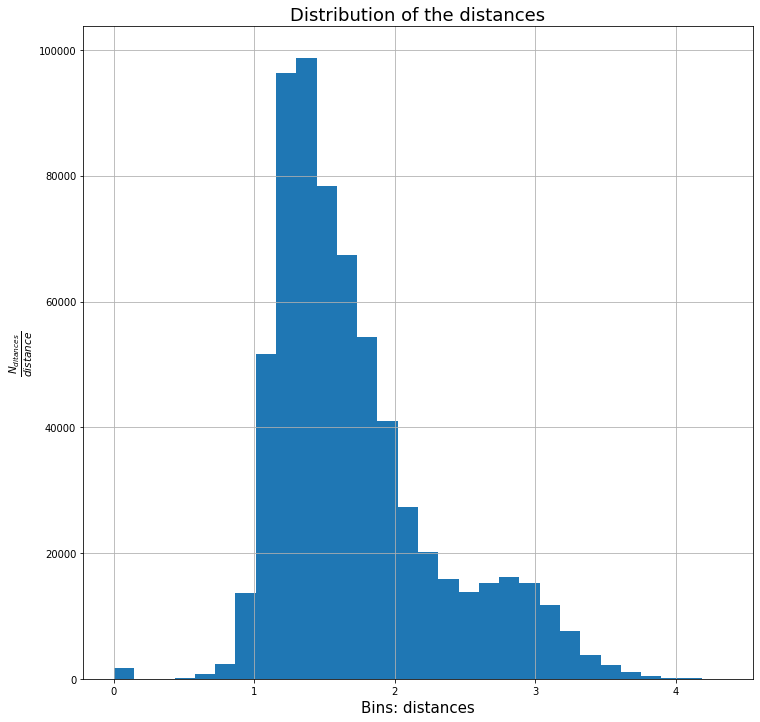

In [0]:
data_hist = ds.flatten()
#bins = (np.amax(data_hist)-np.amin(data_hist)).astype(int)

fig, ax = plt.subplots(figsize=(12,12))

plt.xlabel(r'Bins: distances', fontsize=15)
plt.ylabel(r'$\frac{N_{ditances}}{distance}$', fontsize=15)
plt.title('Distribution of the distances', fontsize=18)
plt.grid()

N, _, patches = ax.hist(data_hist, bins = 30)



# [t-SNE](#home) <a id='tsne'></a> 

t-SNE performs a dimensionality reduction. Also PCA was tested but the results were poorer.

Here the each series is a point in a 811 dimension space, where each dimension represent a distance of this series from one of the others.

t-SNE tries to reduce the dimensionality of this space from 811 to 2 in order to have a direct visualization of the data. It is a probabilistic algorithm that keeps distant dissimilar points and nearer similar points preserving the locality structure.

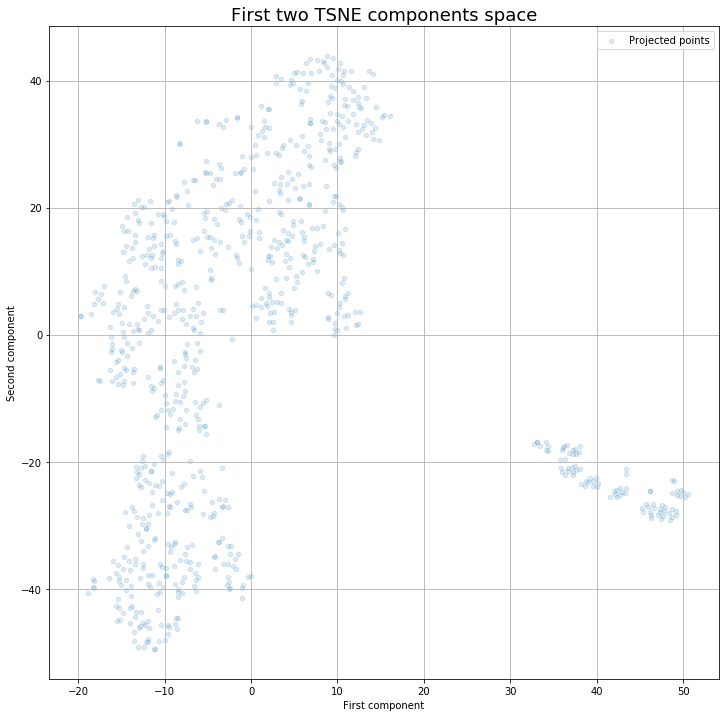

In [6]:
#X_embedded = TSNE(n_components=2).fit_transform(data)
#np.save('outfile', X_embedded)

X_embedded = np.load('outfile.npy')
fig, ax = plt.subplots(figsize = (12, 12))
plt.scatter(X_embedded[:,0], X_embedded[:,1], alpha=0.15, s=20, label='Projected points')

ax.set_title('First two TSNE components space', fontsize = 18)
ax.set_xlabel('First component')
ax.set_ylabel('Second component')
boundx=ax.get_xbound()
boundy=ax.get_ybound()
ax.grid(True)
plt.legend()
plt.show()

# [FIRST CLUSTERING](#home)<a id='firstclustering'></a> 

"The silhouette value is a measure of how similar an object is to its own cluster (cohesion) compared to other clusters (separation). The silhouette ranges from −1 to +1, where a high value indicates that the object is well matched to its own cluster and poorly matched to neighboring clusters. If most objects have a high value, then the clustering configuration is appropriate. If many points have a low or negative value, then the clustering configuration may have too many or too few clusters."

Two different clustering algorithms were implemented:
1. [K-Mean](#kmean)
2. [Agglomerative Clustering](#ac)
For each of them the right number of clusters is found using the Silhouette index and the [best result](#best) is always 3.

## [K-MEAN SELECTION](#firstclustering) <a id='kmean'></a> 

First selection of number of clusters using Silhouette index and K-Mean algorithm.

For n_clusters = 2 The average silhouette_score is : 0.52199674
For n_clusters = 3 The average silhouette_score is : 0.61220497
For n_clusters = 4 The average silhouette_score is : 0.5456535
For n_clusters = 5 The average silhouette_score is : 0.52382123
For n_clusters = 6 The average silhouette_score is : 0.5460199


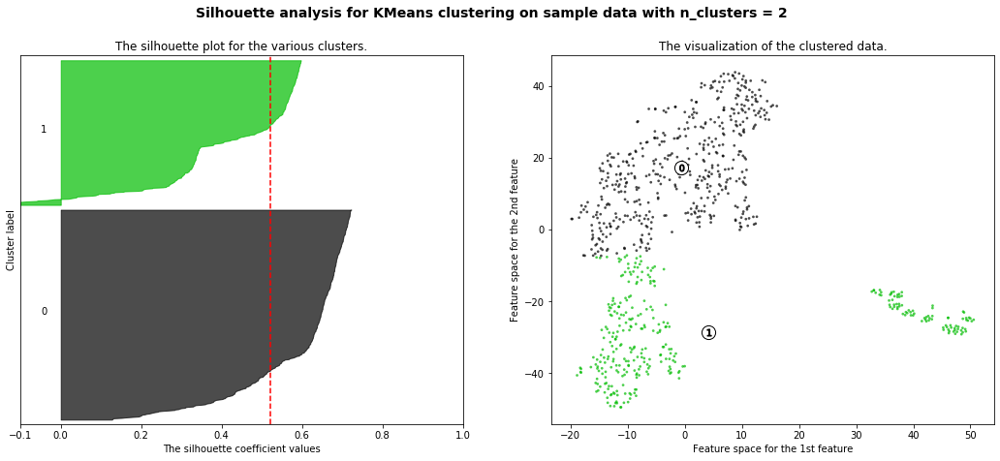

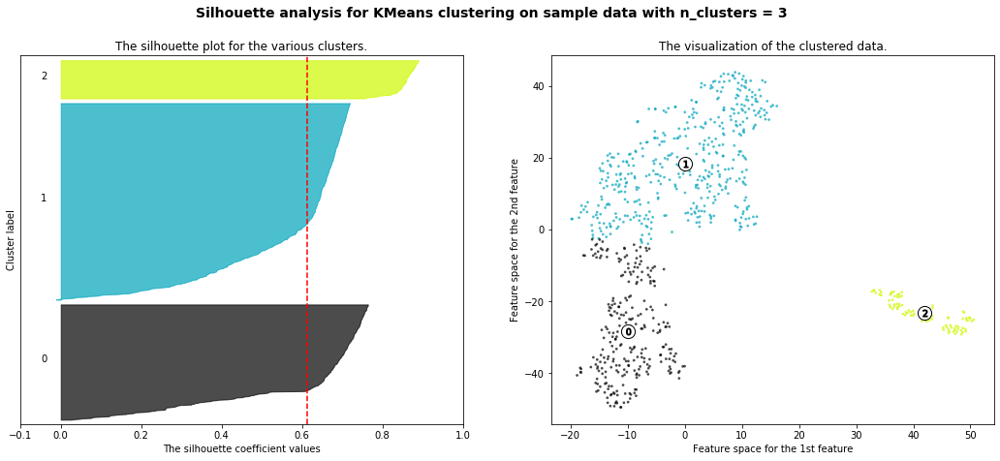

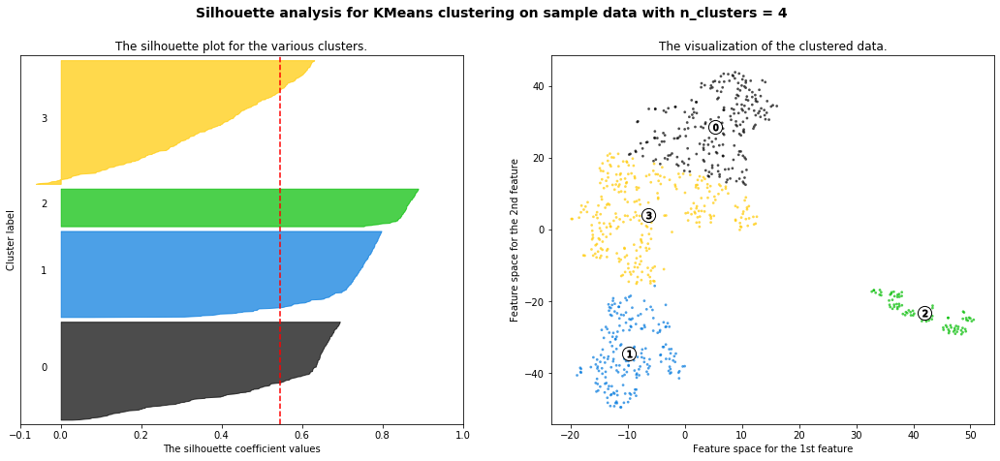

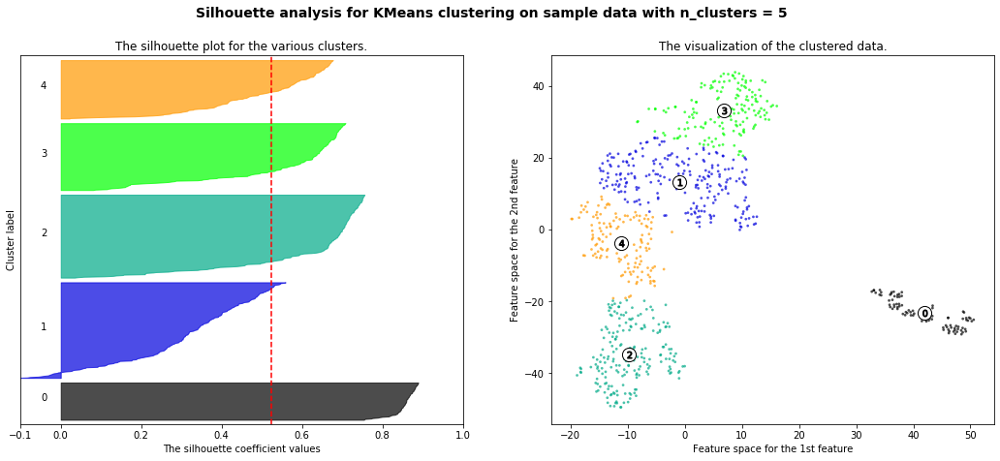

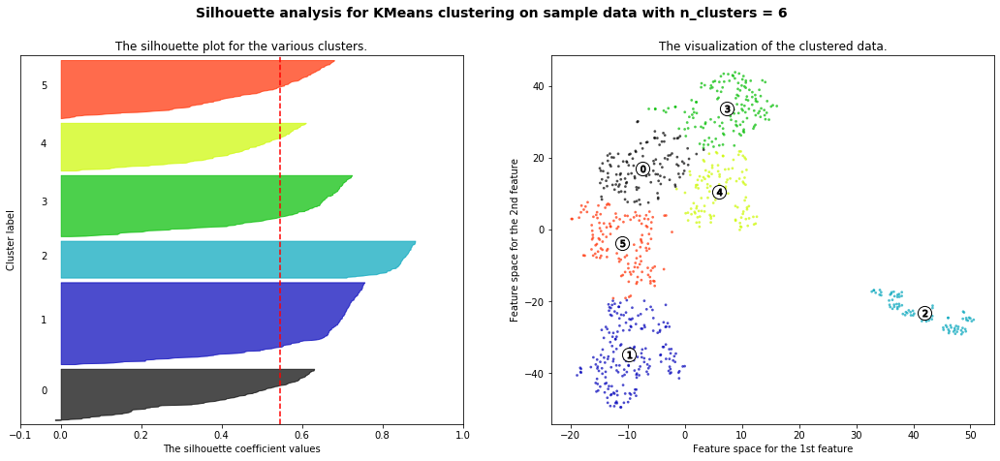

In [0]:
X=X_embedded
range_n_clusters = [2, 3, 4, 5, 6]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

## [AGGLOMERATIVE SELECTION](#firstclustering)<a id='ac'></a> 

Second selection of number of clusters using Silhouette index and Agglomerative Clustering algorithm.

For n_clusters = 2 The average silhouette_score is : 0.5279057
For n_clusters = 3 The average silhouette_score is : 0.6111136
For n_clusters = 4 The average silhouette_score is : 0.5325188
For n_clusters = 5 The average silhouette_score is : 0.5170111
For n_clusters = 6 The average silhouette_score is : 0.5221888


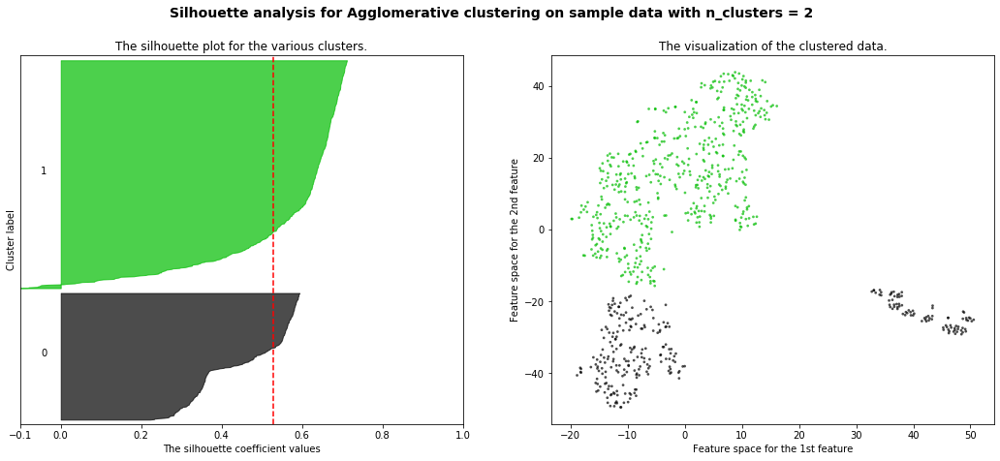

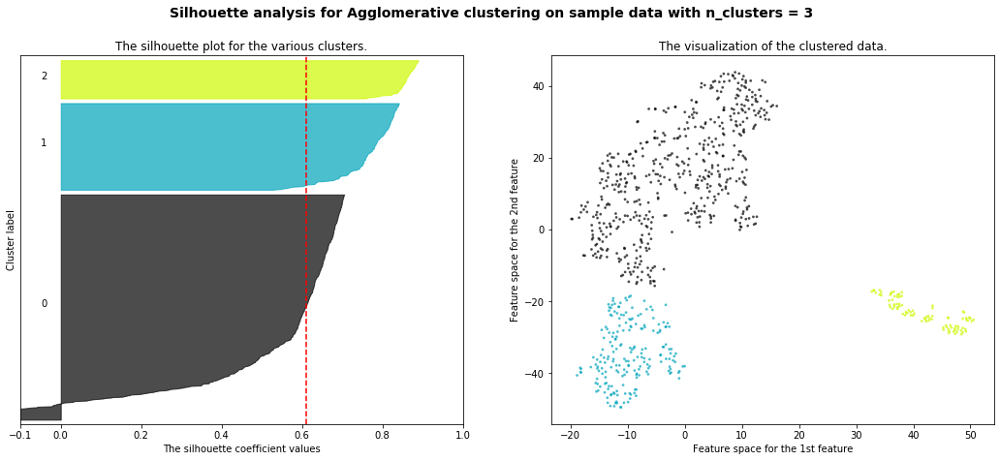

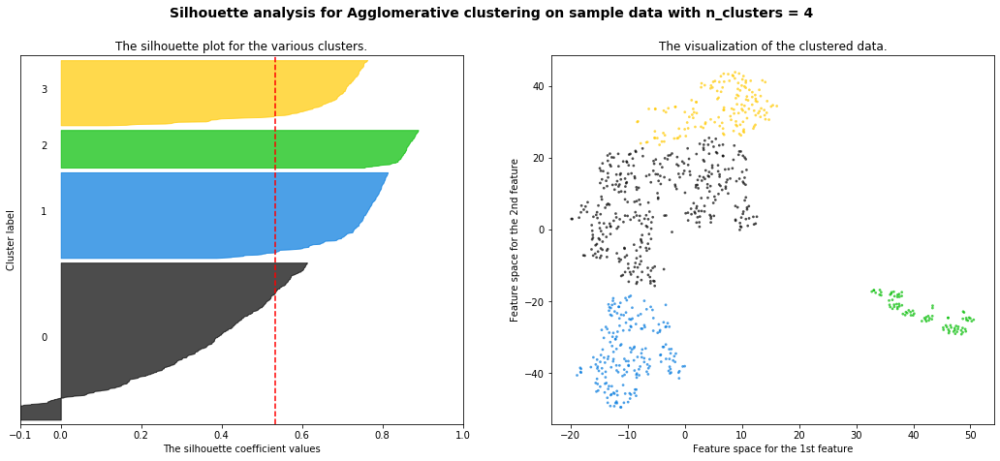

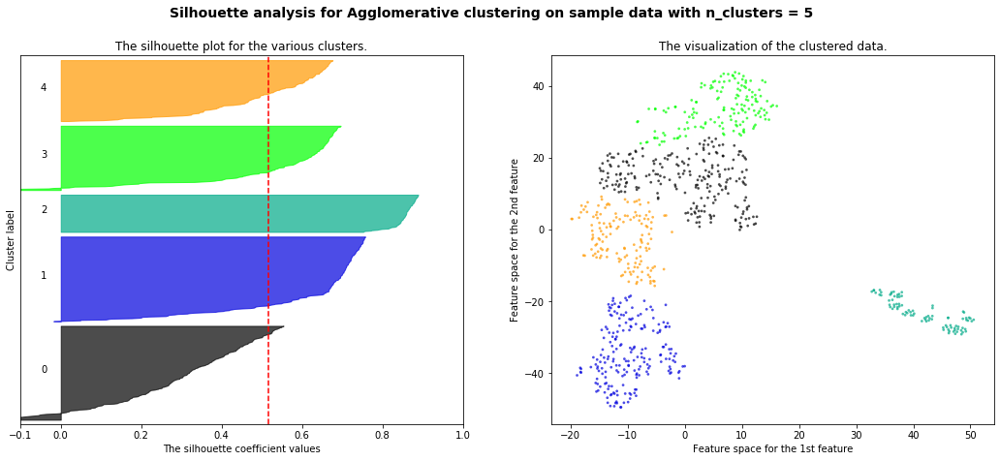

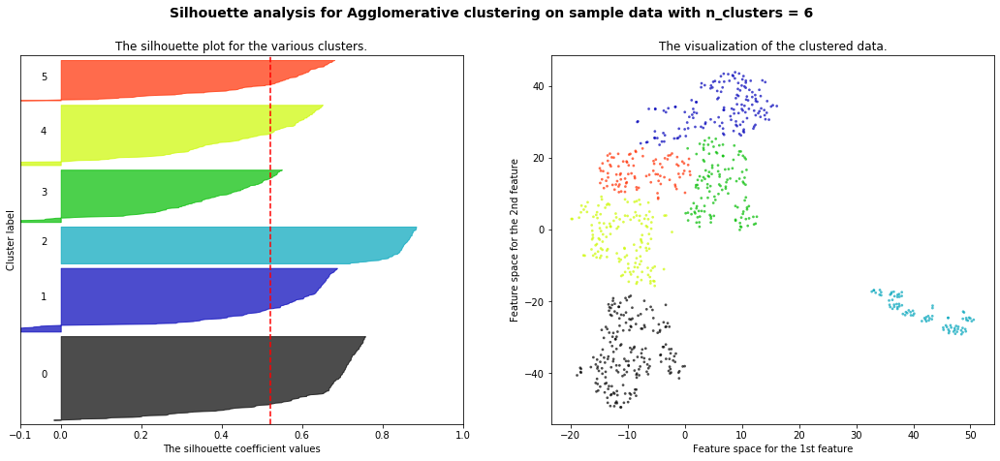

In [0]:
X=X_embedded
range_n_clusters = [2, 3, 4, 5, 6]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = AgglomerativeClustering(n_clusters=n_clusters)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')




    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for Agglomerative clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

## [AGGLOMERATIVE CLUSTERING N=3](#firstclustering)<a id='best'></a> 

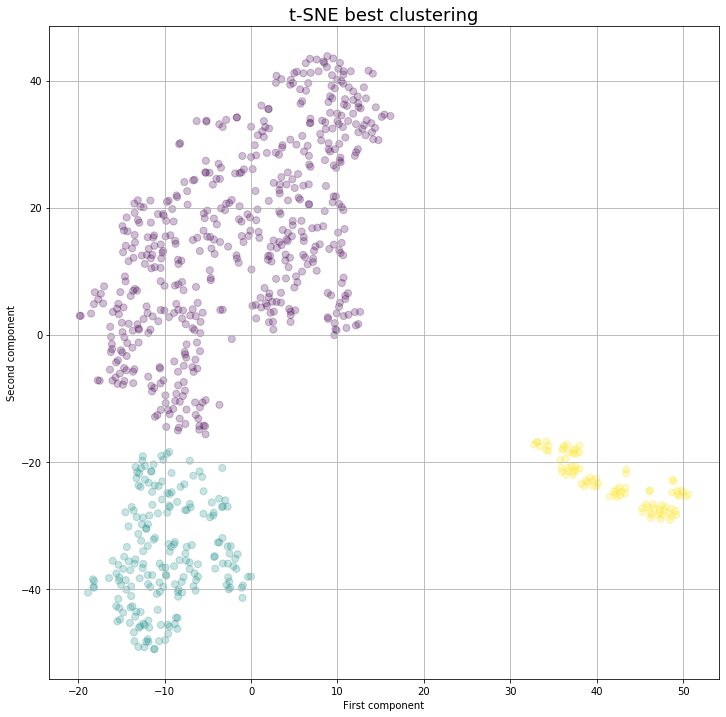

In [7]:
clustering = AgglomerativeClustering(n_clusters=3).fit(X_embedded)
plt.figure(figsize=(12,12))
plt.scatter(X_embedded[:,0], X_embedded[:,1], c=clustering.labels_, cmap="viridis", s=50, marker="o",alpha=0.25)
plt.title('t-SNE best clustering', fontsize = 18)
plt.xlabel('First component')
plt.ylabel('Second component')
#boundx=plt.xbound()
#boundy=plt.ybound()
plt.grid(True)
#plt.legend()
plt.show()

## CLUSTERING TREE

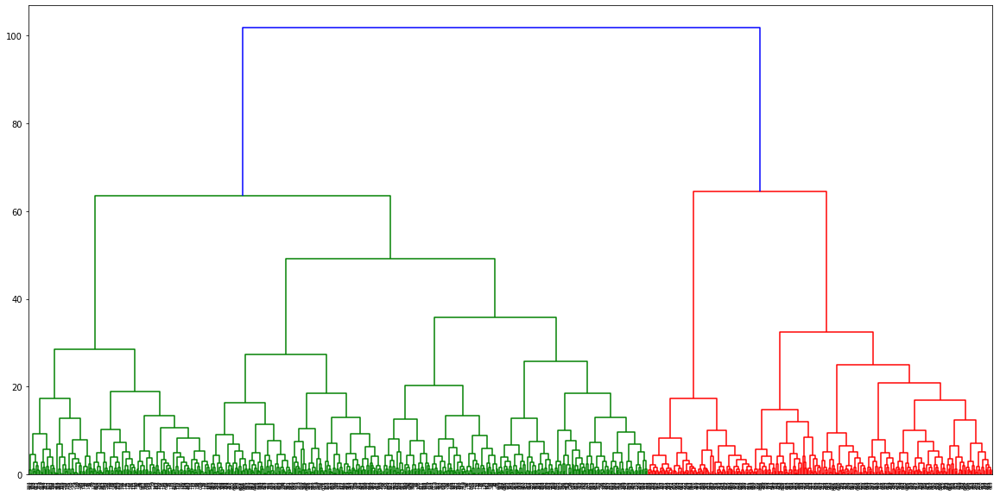

In [0]:
def get_distances(X,model,mode='l2'):
    distances = []
    weights = []
    children=model.children_
    dims = (X.shape[1],1)
    distCache = {}
    weightCache = {}
    for childs in children:
        c1 = X[childs[0]].reshape(dims)
        c2 = X[childs[1]].reshape(dims)
        c1Dist = 0
        c1W = 1
        c2Dist = 0
        c2W = 1
        if childs[0] in distCache.keys():
            c1Dist = distCache[childs[0]]
            c1W = weightCache[childs[0]]
        if childs[1] in distCache.keys():
            c2Dist = distCache[childs[1]]
            c2W = weightCache[childs[1]]
        d = np.linalg.norm(c1-c2)
        cc = ((c1W*c1)+(c2W*c2))/(c1W+c2W)

        X = np.vstack((X,cc.T))

        newChild_id = X.shape[0]-1

        # How to deal with a higher level cluster merge with lower distance:
        if mode=='l2':  # Increase the higher level cluster size suing an l2 norm
            added_dist = (c1Dist**2+c2Dist**2)**0.5 
            dNew = (d**2 + added_dist**2)**0.5
        elif mode == 'max':  # If the previrous clusters had higher distance, use that one
            dNew = max(d,c1Dist,c2Dist)
        elif mode == 'actual':  # Plot the actual distance.
            dNew = d


        wNew = (c1W + c2W)
        distCache[newChild_id] = dNew
        weightCache[newChild_id] = wNew

        distances.append(dNew)
        weights.append( wNew)
    return distances, weights

X=X_embedded

# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(distance_threshold=0, n_clusters=None)
model.fit(X)
distance, weight = get_distances(X,model)
linkage_matrix = np.column_stack([model.children_, distance, weight]).astype(float)
plt.figure(figsize=(20,10))
dendrogram(linkage_matrix)
plt.show()



# [SECOND CLUSTERING](#home)<a id='secondclustering'></a> 

The first procedure seems work well, in fact each group is characterized by a specific property:
1. [Group 0](#0) contains the time series that take continuous values between 0 and 1;
2. [Group 1](#1) contains the time series that take only a small set of values between 0 and 1;
3. [Group 2](#2) contains the time series that take only values 0 or 1.

For each of the 3 big clusters found in the first procedure, another clustering is applied. Again the most appropriate number of clusters is found maximizing the Silhouette index

## [GROUP 0](#secondclustering) <a id='0'></a> 

### Silhouette analysis

In [8]:
group0=X_embedded[clustering.labels_==0]
X=group0
range_n_clusters = [i+2 for i in range(500)]

log=[]
for n_clusters in range_n_clusters:
    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = AgglomerativeClustering(n_clusters=n_clusters)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    log.append(silhouette_avg)
    #print("For n_clusters =", n_clusters,
          #"The average silhouette_score is :", silhouette_avg)


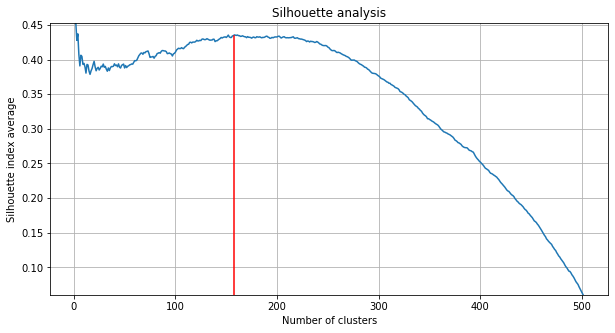

In [10]:
plt.figure(figsize=(10,5))
plt.plot(np.arange(2,502), np.array(log), label='score')
plt.title('Silhouette analysis')
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette index average')
plt.ylim(np.min(log),np.max(log))
num0=np.argmax(log[3:])+3+2
plt.axvline(x=num0, ymax=log[num0-5]/np.max(log), c='r', label='best score index')
plt.grid()


In [0]:
print('Best number of clusters:',np.argmax(log[3:])+3+2)

Best number of clusters: 158


### Best clustering

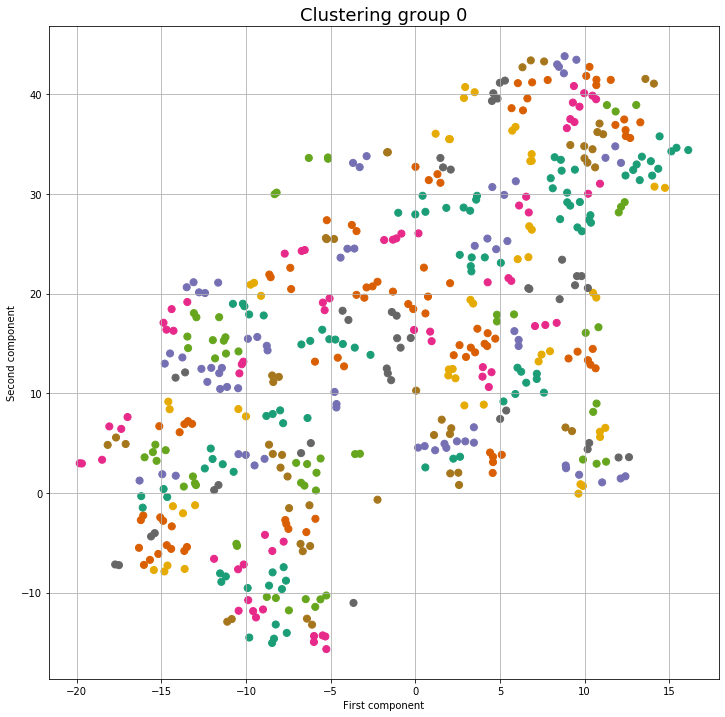

In [9]:
clustering0 = AgglomerativeClustering(n_clusters=158).fit(group0) #184=182+2
plt.figure(figsize=(12,12))
plt.scatter(group0[:,0], group0[:,1], c=clustering0.labels_, cmap="Dark2", s=50, marker="o",alpha=1)
plt.title('Clustering group 0', fontsize = 18)
plt.xlabel('First component')
plt.ylabel('Second component')
#boundx=plt.xbound()
#boundy=plt.ybound()
plt.grid(True)
#plt.legend()
plt.show()

### Plots

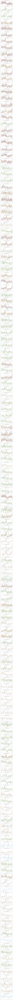

In [0]:
a0=a[clustering.labels_==0]

num=158

fig, axs = plt.subplots(num, 1, figsize=(10,num*5))
axs = axs.ravel()
for i in range(num):
    a0i=a0[clustering0.labels_==i]
    axs[i].set_title('cluster label %d number of series %d' %(i, len(a0i)) )
    for j in range(len(a0i)):
        axs[i].plot(a0i[j])

## [GROUP 1](#secondclustering) <a id='1'></a> 

### Silhouette analysis

In [29]:
group1=X_embedded[clustering.labels_==1]
X=group1
range_n_clusters = [i+2 for i in range(len(group1)-2)]

log=[]
for n_clusters in range_n_clusters:
    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = AgglomerativeClustering(n_clusters=n_clusters)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    log.append(silhouette_avg)
    #print("For n_clusters =", n_clusters,
          #"The average silhouette_score is :", silhouette_avg)

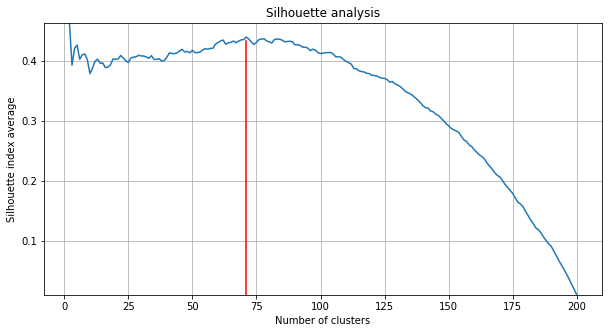

In [13]:
plt.figure(figsize=(10,5))
plt.plot(np.arange(2,(len(group1))), np.array(log), label='score')
plt.title('Silhouette analysis')
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette index average')
plt.ylim(np.min(log),np.max(log))
num1=np.argmax(log[1:])+1+2
plt.axvline(x=num1, ymax=log[num1-5]/np.max(log), c='r', label='best score index')
plt.grid()

In [0]:
print('Best number of clusters:',np.argmax(log[1:])+1+2)

Best number of clusters: 71


### Best clustering

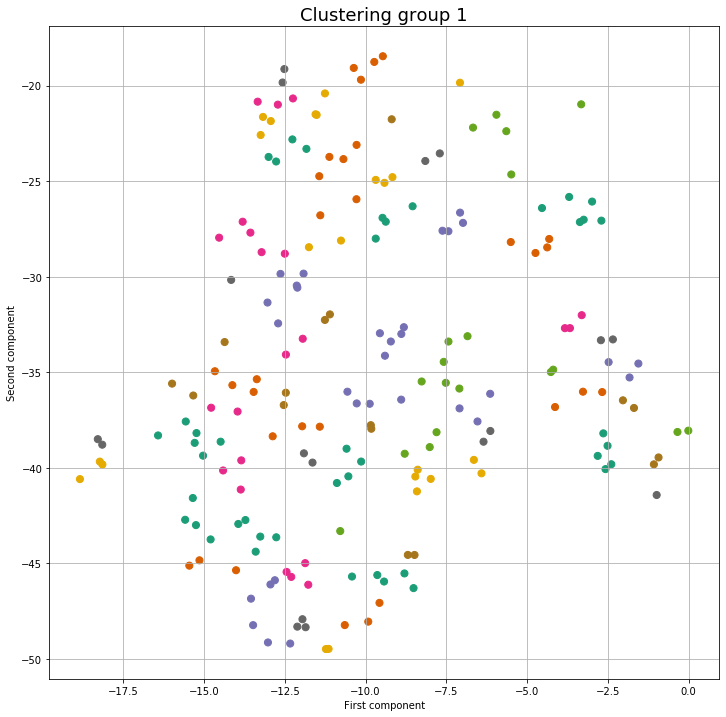

In [30]:
clustering1 = AgglomerativeClustering(n_clusters=71).fit(group1) #184=182+2
plt.figure(figsize=(12,12))
plt.scatter(group1[:,0], group1[:,1], c=clustering1.labels_, cmap="Dark2", s=50, marker="o",alpha=1)
plt.title('Clustering group 1', fontsize = 18)
plt.xlabel('First component')
plt.ylabel('Second component')
#boundx=plt.xbound()
#boundy=plt.ybound()
plt.grid(True)
#plt.legend()
plt.show()

### Plots

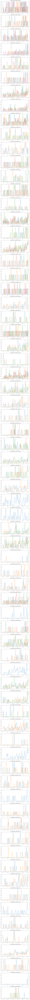

In [0]:
a1=a[clustering.labels_==1]

num=71

fig, axs = plt.subplots(num, 1, figsize=(10,num*5))
axs = axs.ravel()
for i in range(num):
    a1i=a1[clustering1.labels_==i]
    axs[i].set_title('cluster label %d number of series %d' %(i, len(a1i)) )
    for j in range(len(a1i)):
        axs[i].plot(a1i[j])

## [GROUP 2](#secondclustering) <a id='2'></a> 

### Silhouette analysis

In [31]:
group2=X_embedded[clustering.labels_==2]
X=group2
range_n_clusters = [i+2 for i in range(70)]

log=[]
for n_clusters in range_n_clusters:
    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = AgglomerativeClustering(n_clusters=n_clusters)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    log.append(silhouette_avg)
    #print("For n_clusters =", n_clusters,
          #"The average silhouette_score is :", silhouette_avg)


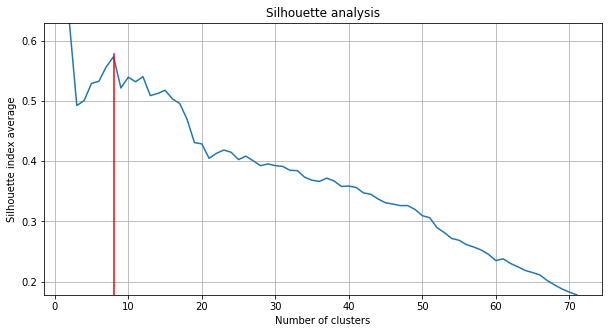

In [17]:
plt.figure(figsize=(10,5))
plt.plot(np.arange(2,72), np.array(log), label='score')
plt.title('Silhouette analysis')
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette index average')
plt.ylim(np.min(log),np.max(log))
num2=np.argmax(log[1:])+1+2
plt.axvline(x=num2, ymax=log[num2-3]/np.max(log), c='r', label='best score index')
plt.grid()

In [0]:
print('Best number of clusters:',np.argmax(log[1:])+1+2)

Best number of clusters: 8


### Best clustering

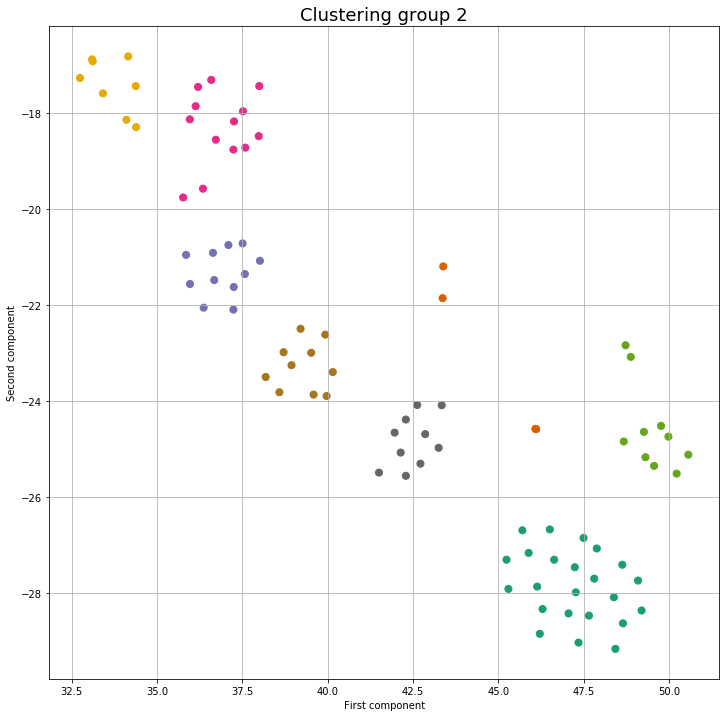

In [32]:
clustering2 = AgglomerativeClustering(n_clusters=8).fit(group2) #8=6+2
plt.figure(figsize=(12,12))
plt.scatter(group2[:,0], group2[:,1], c=clustering2.labels_, cmap="Dark2", s=50, marker="o",alpha=1)
plt.title('Clustering group 2', fontsize = 18)
plt.xlabel('First component')
plt.ylabel('Second component')
#boundx=plt.xbound()
#boundy=plt.ybound()
plt.grid(True)
#plt.legend()
plt.show()

### Plots

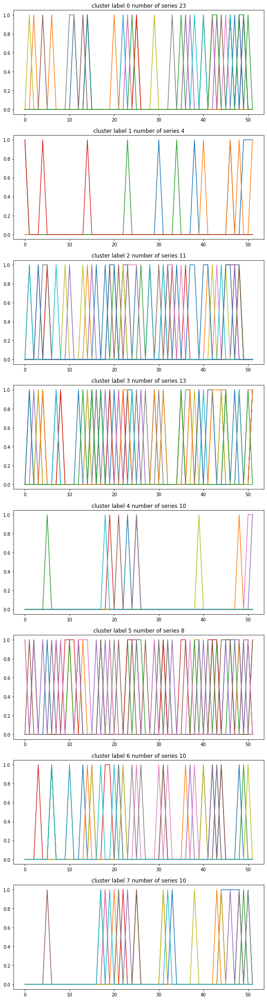

In [0]:
a2=a[clustering.labels_==2]

num=8

fig, axs = plt.subplots(num, 1, figsize=(10,num*5))
axs = axs.ravel()
for i in range(num):
    a2i=a2[clustering2.labels_==i]
    axs[i].set_title('cluster label %d number of series %d' %(i, len(a2i)) )
    for j in range(len(a2i)):
        axs[i].plot(a2i[j])


# [CAUSALITY](#home)<a id='causa'></a> 

In [33]:
b0=b[clustering.labels_==0]
num0=158
b1=b[clustering.labels_==1]
num1=71
b2=b[clustering.labels_==2]
num2=8

### Group 0

For what concerns group 0 only one cluster has only one disconnected node and there are 5 clusters are composed of one single time series

data shape: (52, 8)
CAUSATION MATRIX


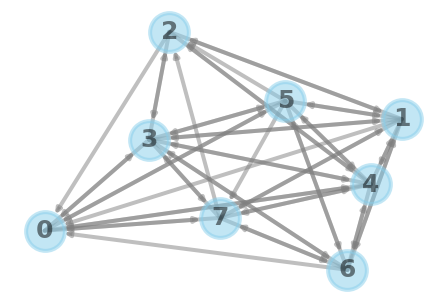

data shape: (52, 3)
CAUSATION MATRIX


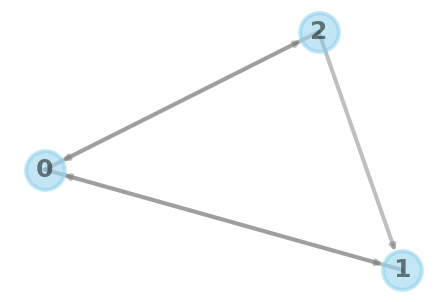

data shape: (52, 3)
CAUSATION MATRIX


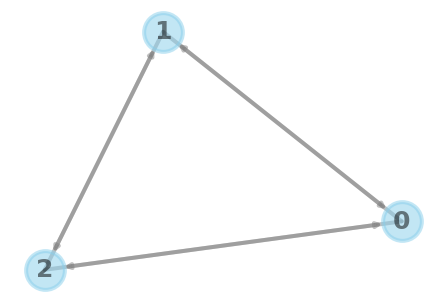

data shape: (52, 4)
CAUSATION MATRIX


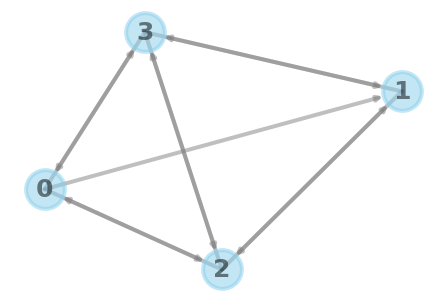

data shape: (52, 6)
CAUSATION MATRIX


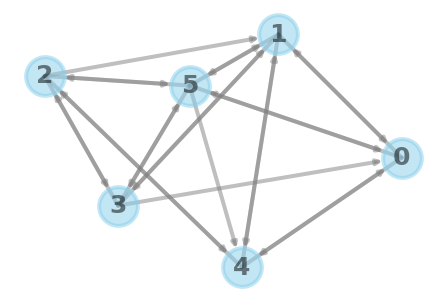

data shape: (52, 5)
CAUSATION MATRIX


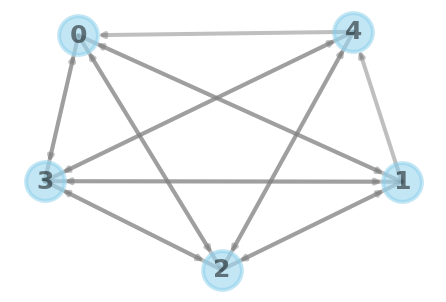

data shape: (52, 5)
CAUSATION MATRIX


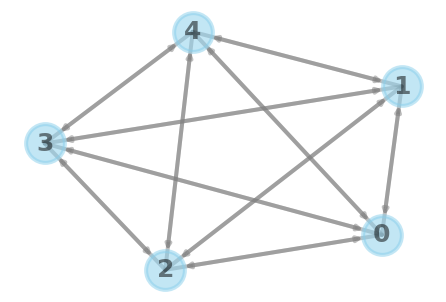

data shape: (52, 5)
CAUSATION MATRIX


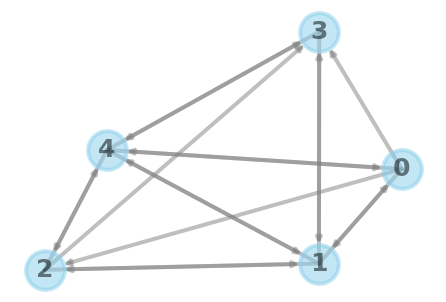

data shape: (52, 5)
CAUSATION MATRIX


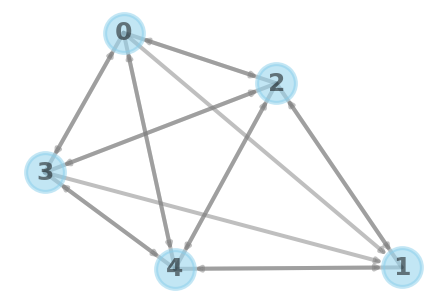

data shape: (52, 5)
CAUSATION MATRIX


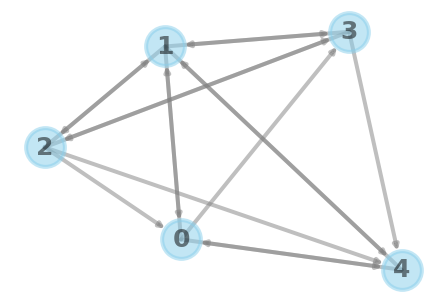

data shape: (52, 4)
CAUSATION MATRIX


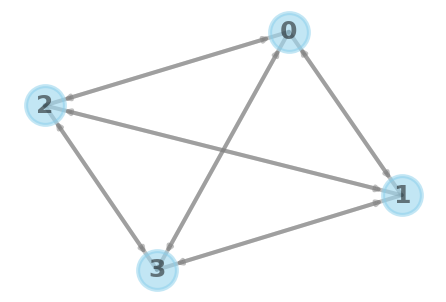

data shape: (52, 5)
CAUSATION MATRIX


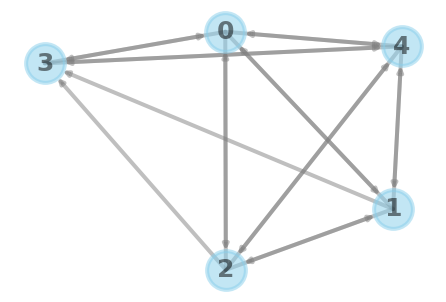

data shape: (52, 4)
CAUSATION MATRIX


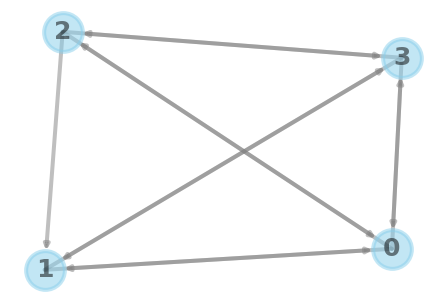

data shape: (52, 5)
CAUSATION MATRIX


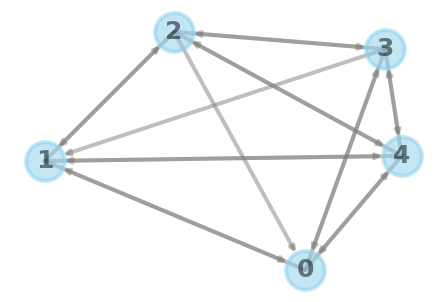

data shape: (52, 6)
CAUSATION MATRIX


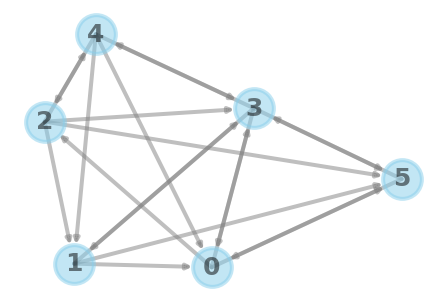

data shape: (52, 5)
CAUSATION MATRIX


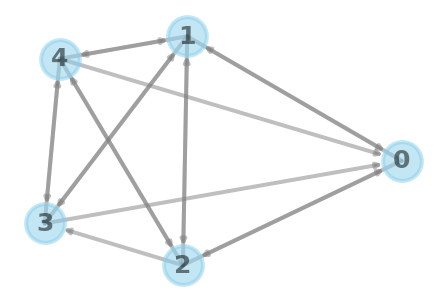

data shape: (52, 5)
CAUSATION MATRIX


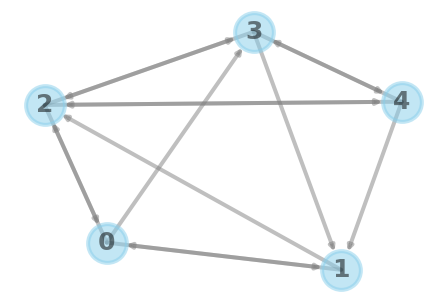

data shape: (52, 4)
CAUSATION MATRIX


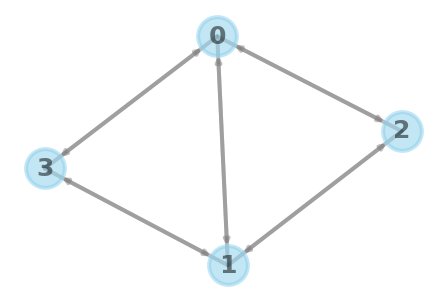

data shape: (52, 5)
CAUSATION MATRIX


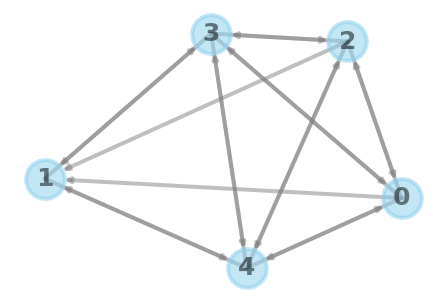

data shape: (52, 3)
CAUSATION MATRIX


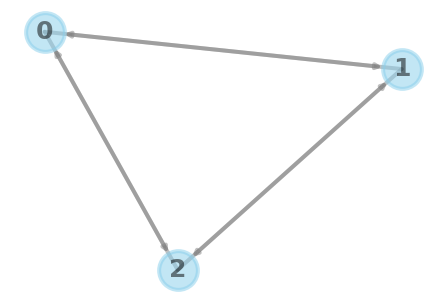

data shape: (52, 5)
CAUSATION MATRIX


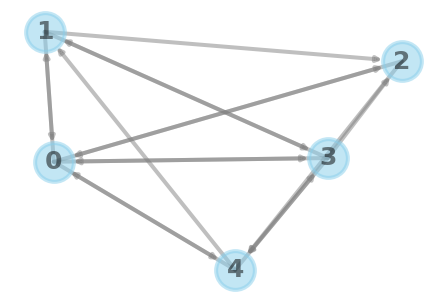

data shape: (52, 5)
CAUSATION MATRIX


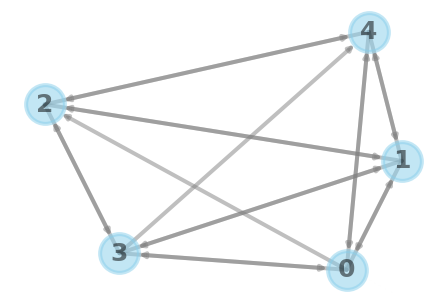

data shape: (52, 6)
CAUSATION MATRIX


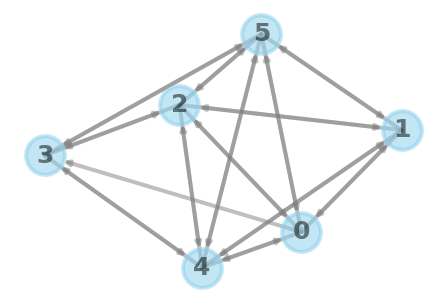

data shape: (52, 5)
CAUSATION MATRIX


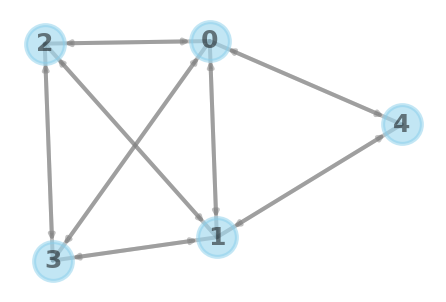

data shape: (52, 6)
CAUSATION MATRIX


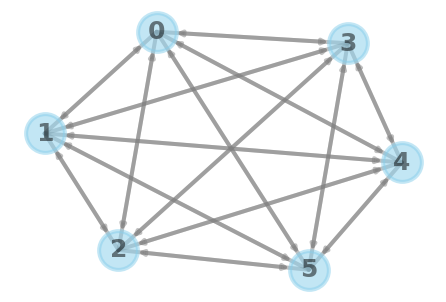

data shape: (52, 5)
CAUSATION MATRIX


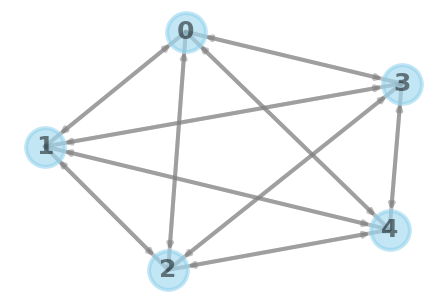

data shape: (52, 3)
CAUSATION MATRIX


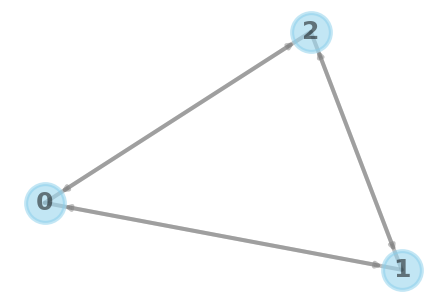

data shape: (52, 3)
CAUSATION MATRIX


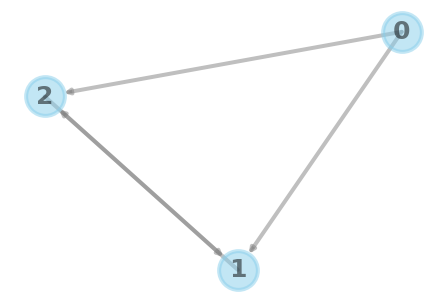

data shape: (52, 3)
CAUSATION MATRIX


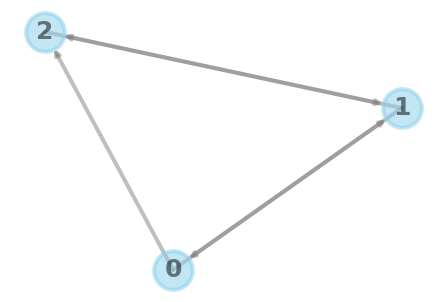

data shape: (52, 5)
CAUSATION MATRIX


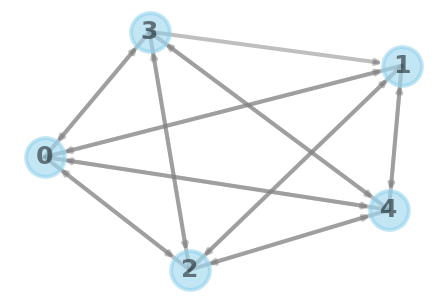

data shape: (52, 4)
CAUSATION MATRIX


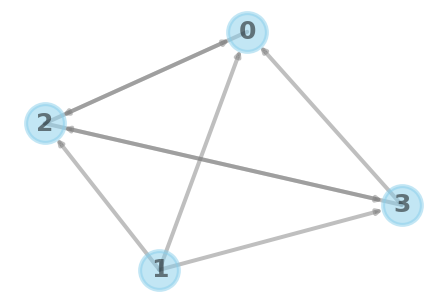

data shape: (52, 6)
CAUSATION MATRIX


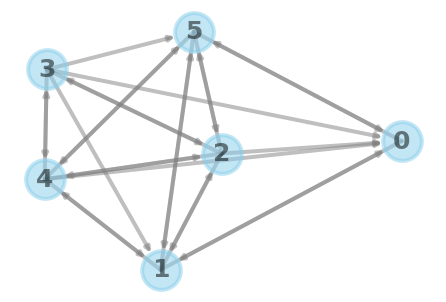

data shape: (52, 4)
CAUSATION MATRIX


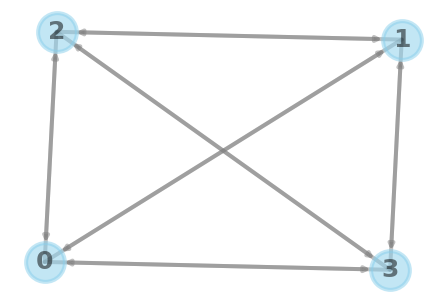

data shape: (52, 4)
CAUSATION MATRIX


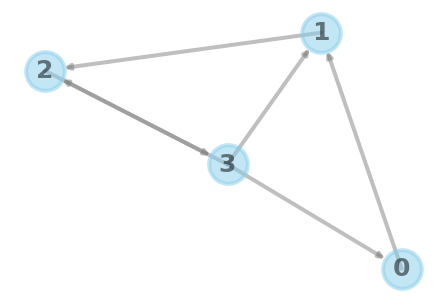

data shape: (52, 5)
CAUSATION MATRIX


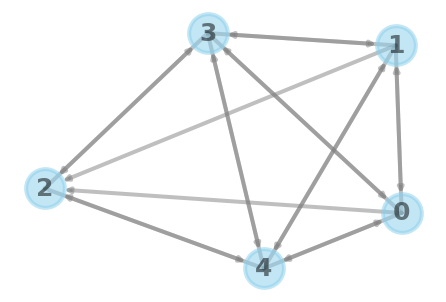

data shape: (52, 2)
CAUSATION MATRIX


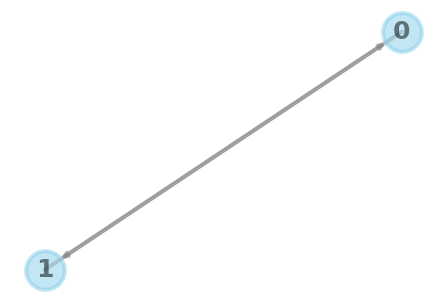

data shape: (52, 3)
CAUSATION MATRIX


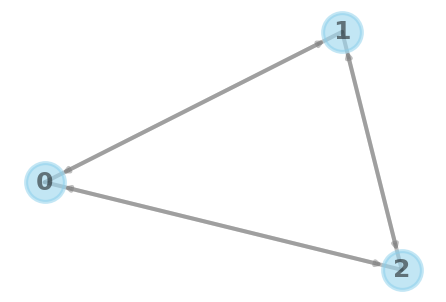

data shape: (52, 5)
CAUSATION MATRIX


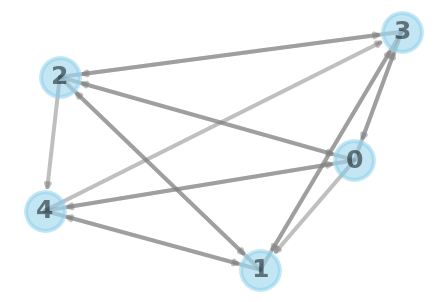

data shape: (52, 5)
CAUSATION MATRIX


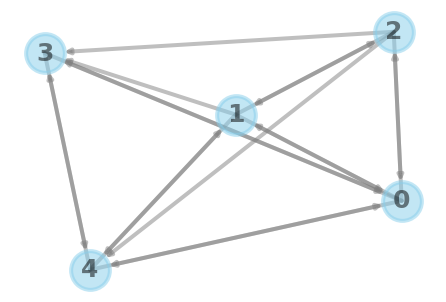

data shape: (52, 3)
CAUSATION MATRIX


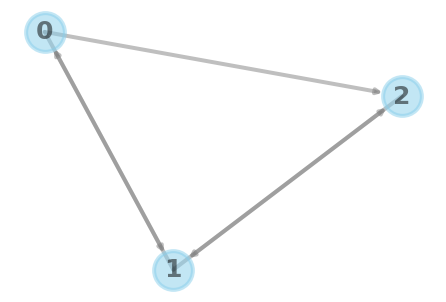

data shape: (52, 4)
CAUSATION MATRIX


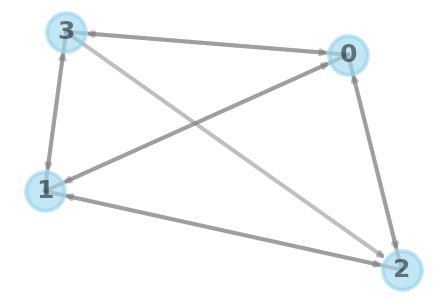

data shape: (52, 3)
CAUSATION MATRIX


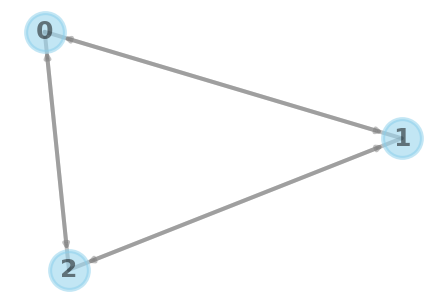

data shape: (52, 3)
CAUSATION MATRIX


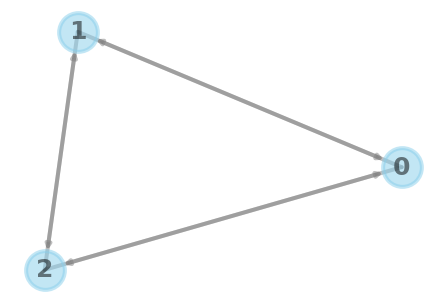

data shape: (52, 4)
CAUSATION MATRIX


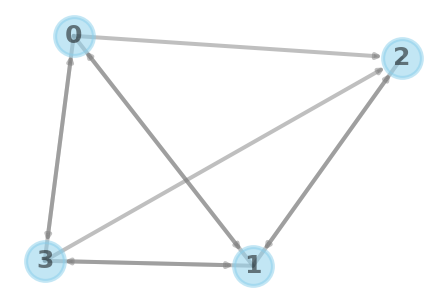

data shape: (52, 5)
CAUSATION MATRIX


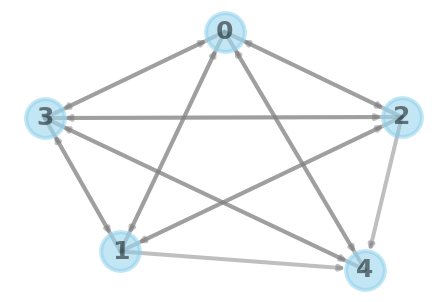

data shape: (52, 5)
CAUSATION MATRIX


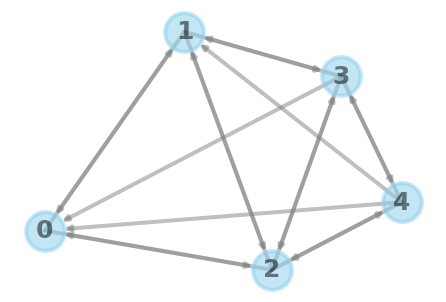

data shape: (52, 3)
CAUSATION MATRIX


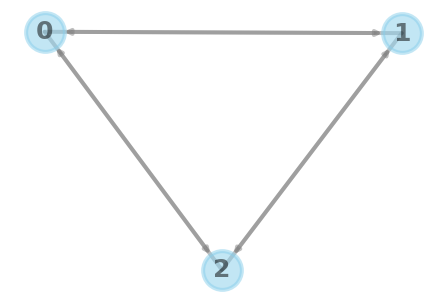

data shape: (52, 4)
CAUSATION MATRIX


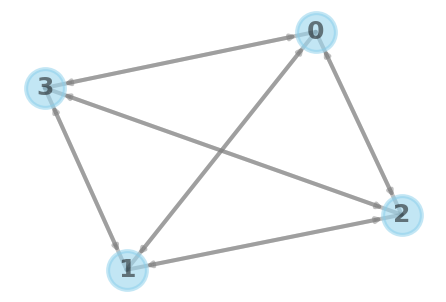

data shape: (52, 5)
CAUSATION MATRIX


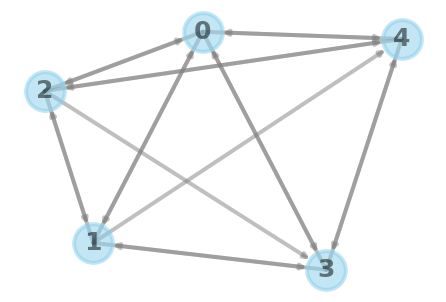

data shape: (52, 4)
CAUSATION MATRIX


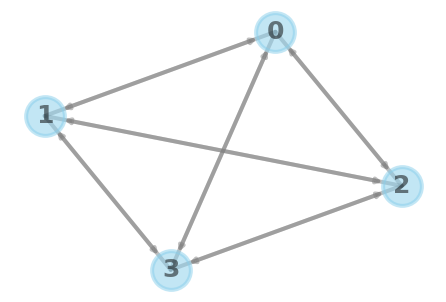

data shape: (52, 3)
CAUSATION MATRIX


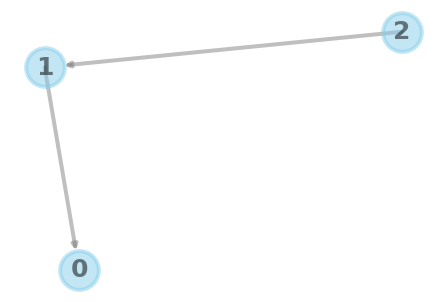

data shape: (52, 3)
CAUSATION MATRIX


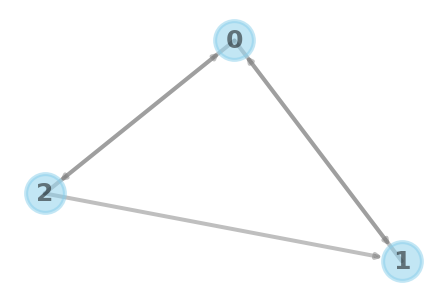

data shape: (52, 3)
CAUSATION MATRIX


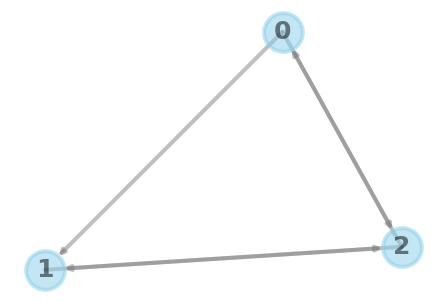

data shape: (52, 3)
CAUSATION MATRIX


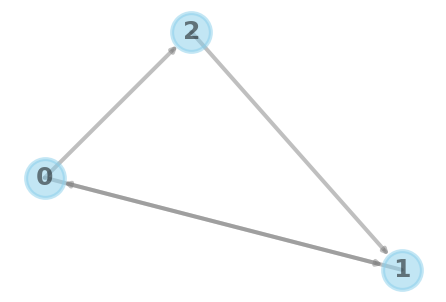

data shape: (52, 3)
CAUSATION MATRIX


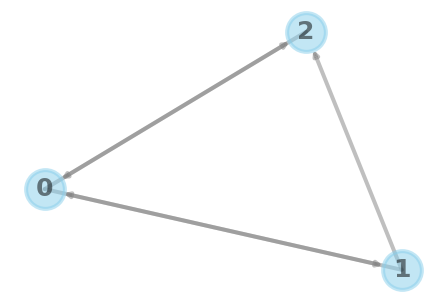

data shape: (52, 3)
CAUSATION MATRIX


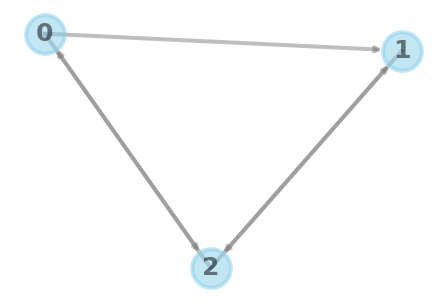

data shape: (52, 3)
CAUSATION MATRIX


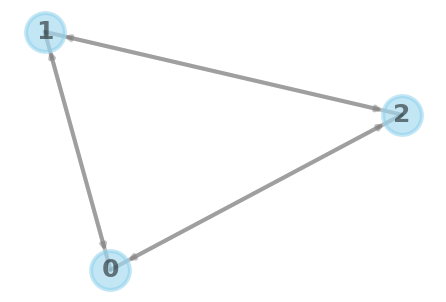

data shape: (52, 5)
CAUSATION MATRIX


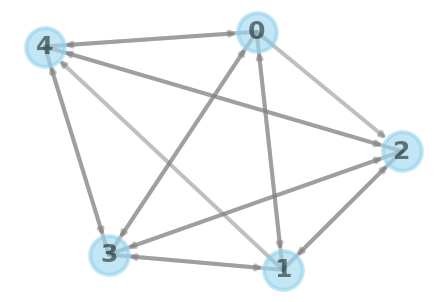

data shape: (52, 3)
CAUSATION MATRIX


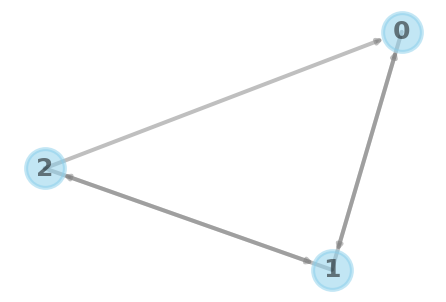

data shape: (52, 5)
CAUSATION MATRIX


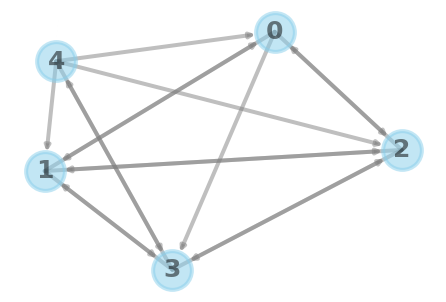

data shape: (52, 3)
CAUSATION MATRIX


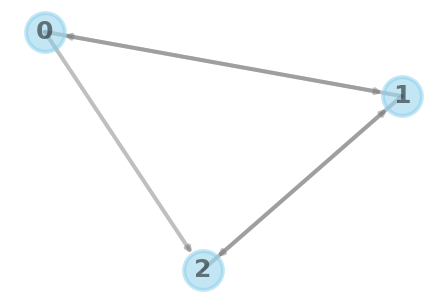

data shape: (52, 3)
CAUSATION MATRIX


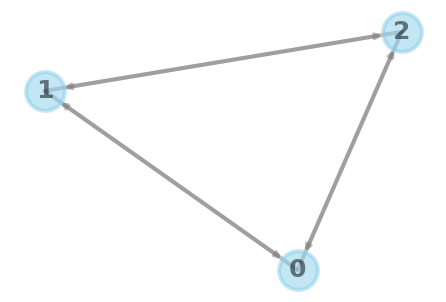

data shape: (52, 2)
CAUSATION MATRIX


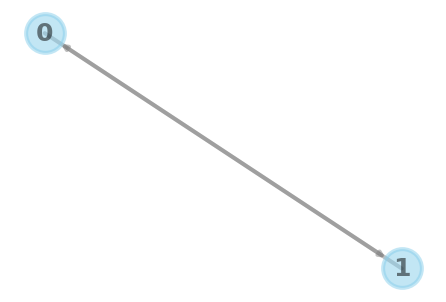

data shape: (52, 3)
CAUSATION MATRIX


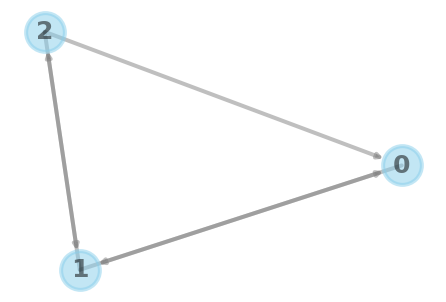

data shape: (52, 3)
CAUSATION MATRIX


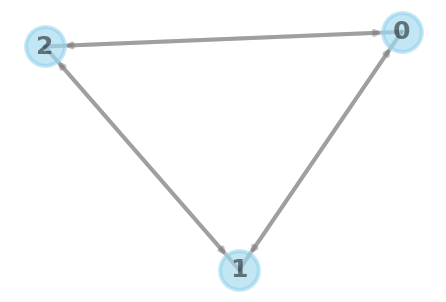

data shape: (52, 3)
CAUSATION MATRIX


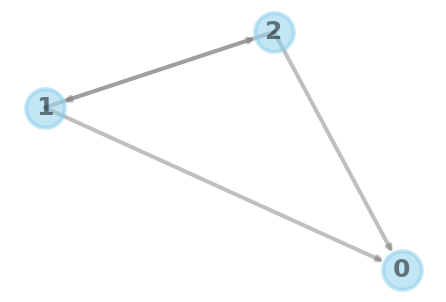

data shape: (52, 3)
CAUSATION MATRIX


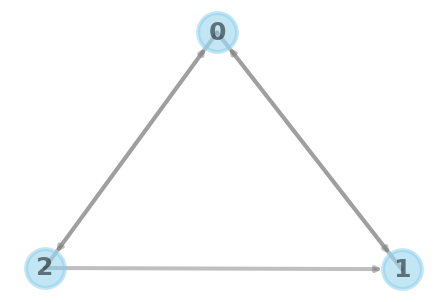

data shape: (52, 4)
CAUSATION MATRIX


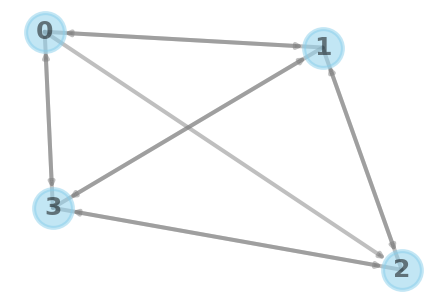

data shape: (52, 5)
CAUSATION MATRIX


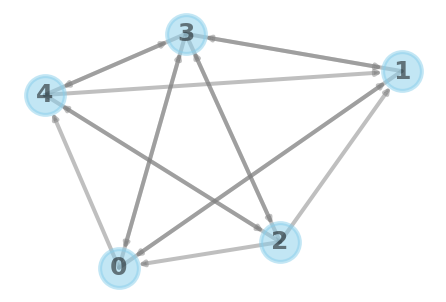

data shape: (52, 5)
CAUSATION MATRIX


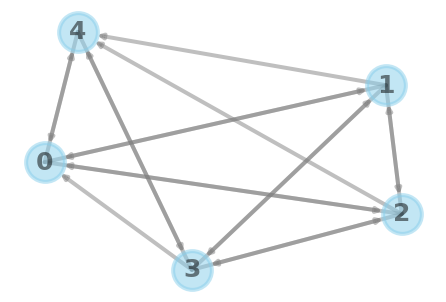

data shape: (52, 3)
CAUSATION MATRIX


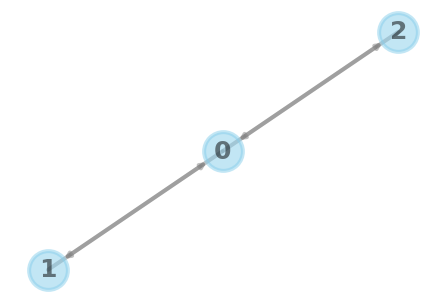

data shape: (52, 3)
CAUSATION MATRIX


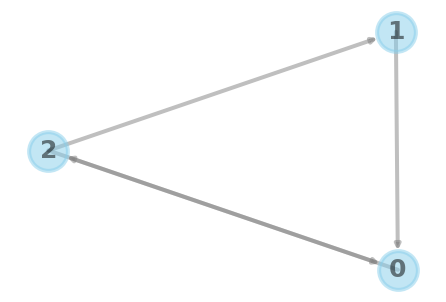

data shape: (52, 3)
CAUSATION MATRIX


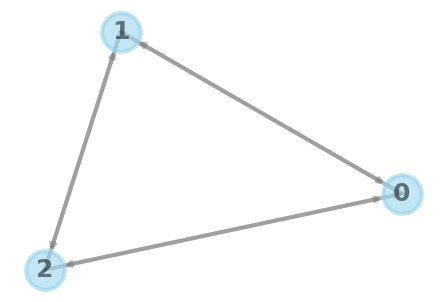

data shape: (52, 2)
CAUSATION MATRIX


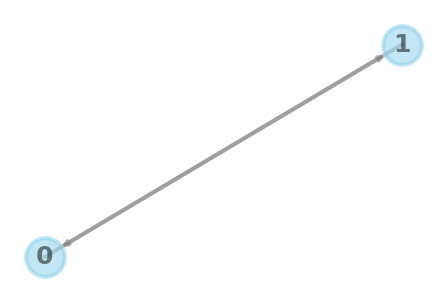

data shape: (52, 3)
CAUSATION MATRIX


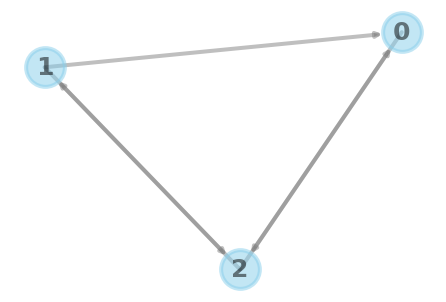

data shape: (52, 3)
CAUSATION MATRIX


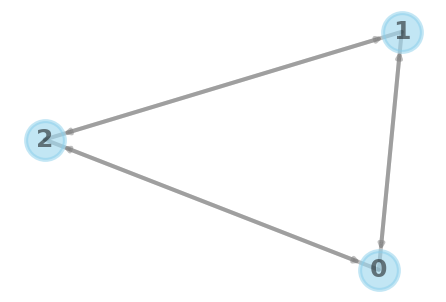

data shape: (52, 3)
CAUSATION MATRIX


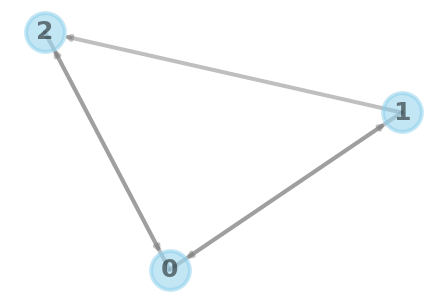

data shape: (52, 3)
CAUSATION MATRIX


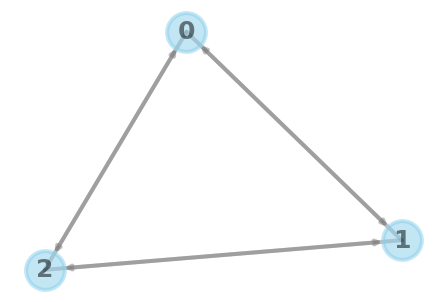

data shape: (52, 6)
CAUSATION MATRIX


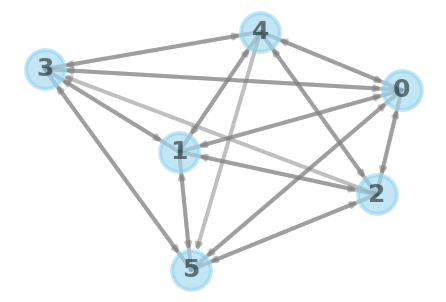

data shape: (52, 3)
CAUSATION MATRIX


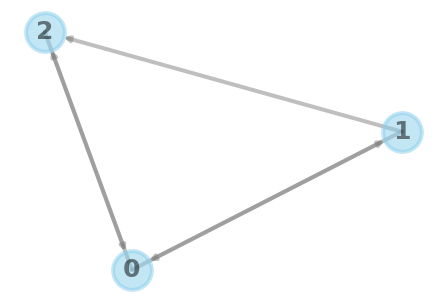

data shape: (52, 3)
CAUSATION MATRIX


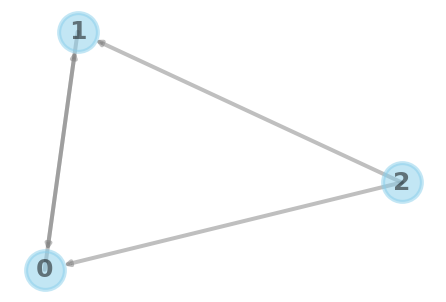

data shape: (52, 4)
CAUSATION MATRIX


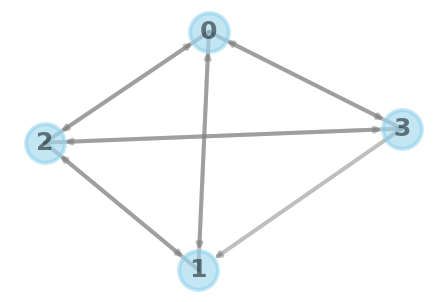

data shape: (52, 3)
CAUSATION MATRIX


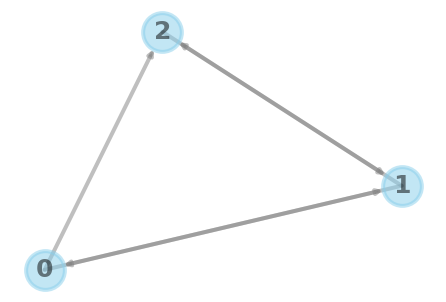

data shape: (52, 3)
CAUSATION MATRIX


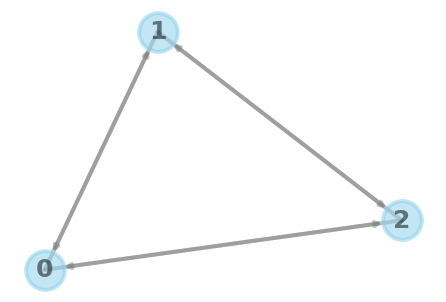

data shape: (52, 4)
CAUSATION MATRIX


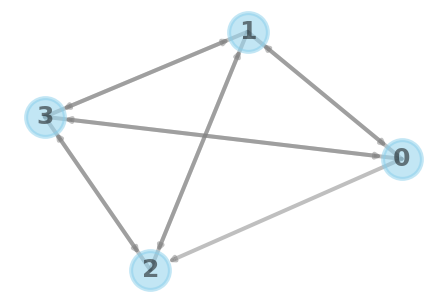

data shape: (52, 2)
CAUSATION MATRIX


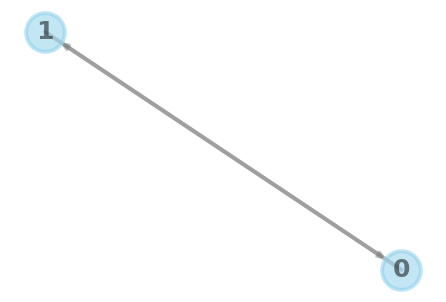

data shape: (52, 2)
CAUSATION MATRIX


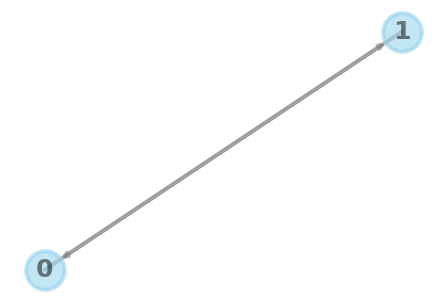

data shape: (52, 2)
CAUSATION MATRIX


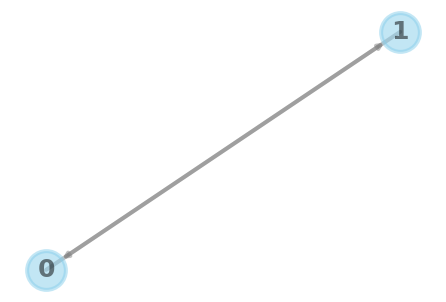

data shape: (52, 3)
CAUSATION MATRIX


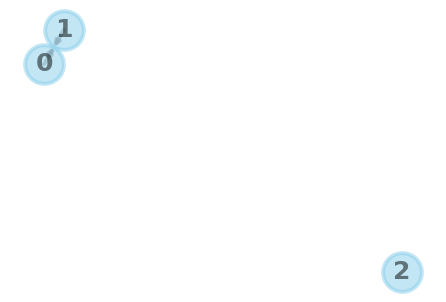

data shape: (52, 2)
CAUSATION MATRIX


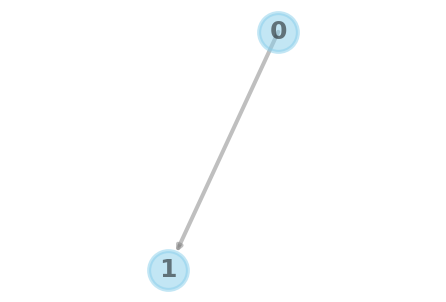

data shape: (52, 2)
CAUSATION MATRIX


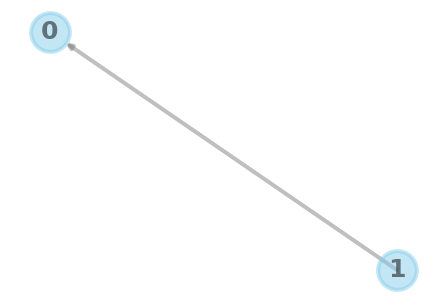

data shape: (52, 3)
CAUSATION MATRIX


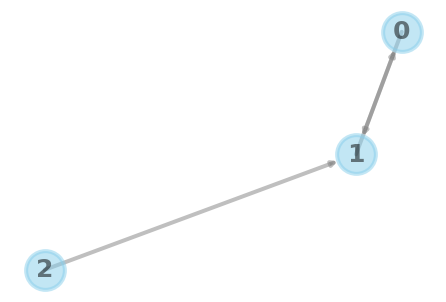

data shape: (52, 5)
CAUSATION MATRIX


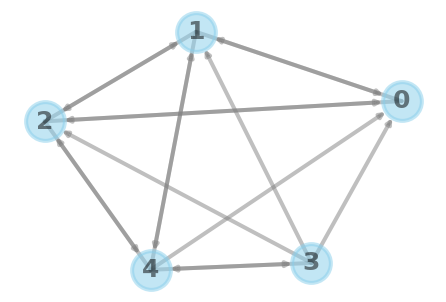

data shape: (52, 3)
CAUSATION MATRIX


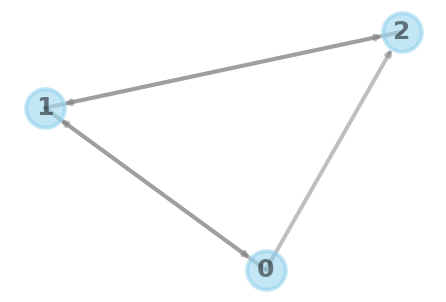

data shape: (52, 3)
CAUSATION MATRIX


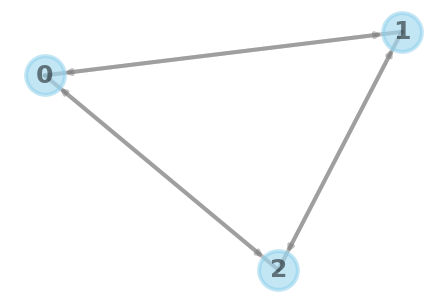

data shape: (52, 4)
CAUSATION MATRIX


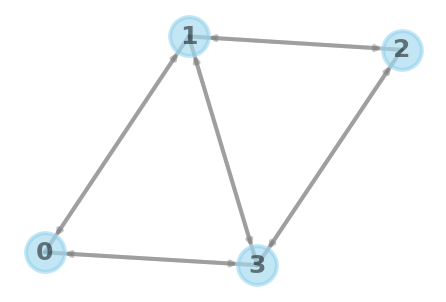

data shape: (52, 3)
CAUSATION MATRIX


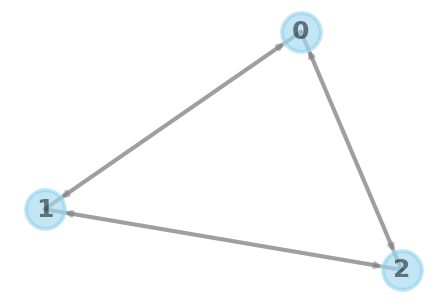

data shape: (52, 3)
CAUSATION MATRIX


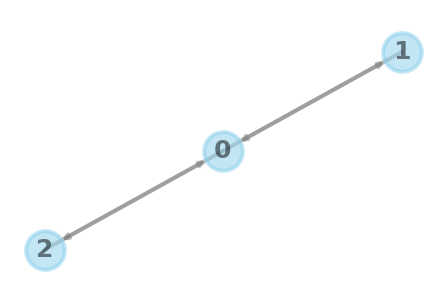

data shape: (52, 2)
CAUSATION MATRIX


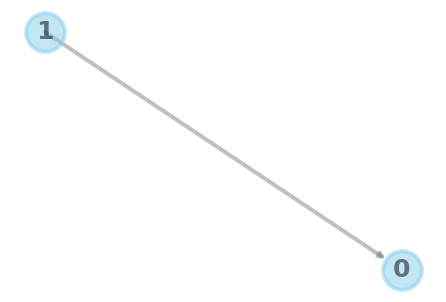

data shape: (52, 4)
CAUSATION MATRIX


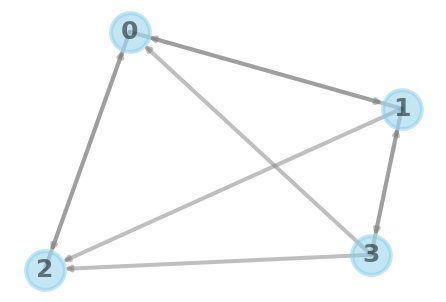

data shape: (52, 4)
CAUSATION MATRIX


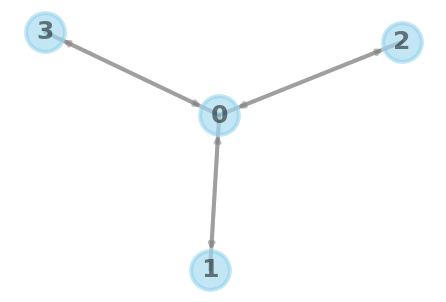

data shape: (52, 3)
CAUSATION MATRIX


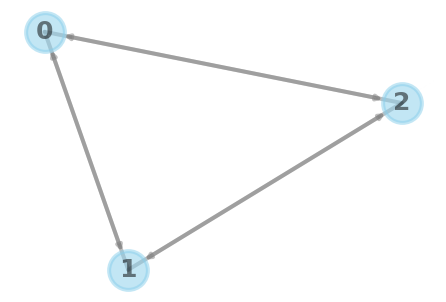

data shape: (52, 2)
CAUSATION MATRIX


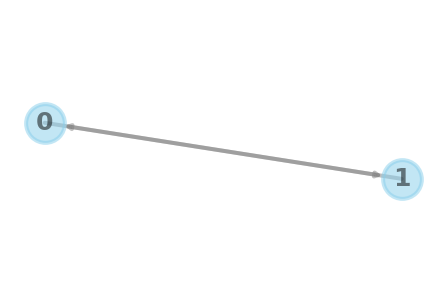

data shape: (52, 2)
CAUSATION MATRIX


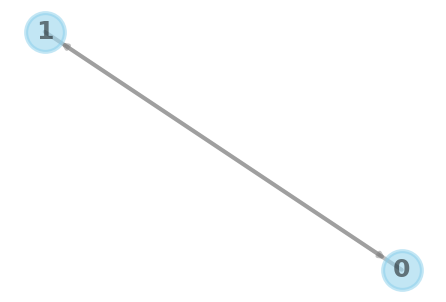

data shape: (52, 3)
CAUSATION MATRIX


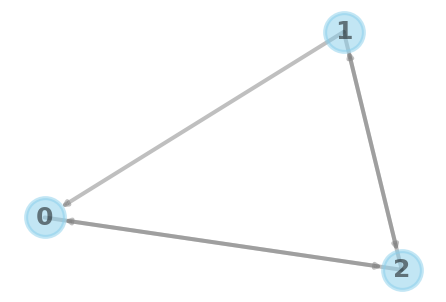

data shape: (52, 3)
CAUSATION MATRIX


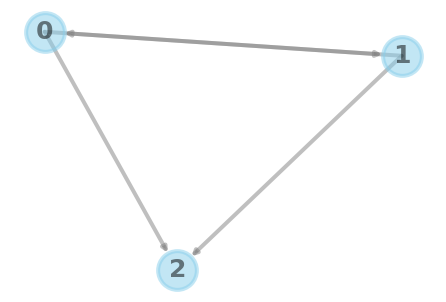

data shape: (52, 2)
CAUSATION MATRIX


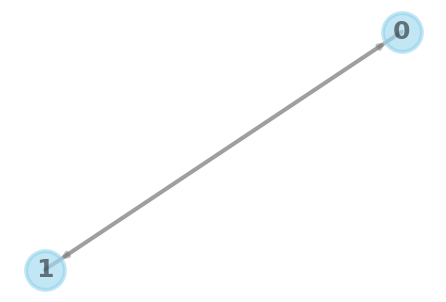

data shape: (52, 3)
CAUSATION MATRIX


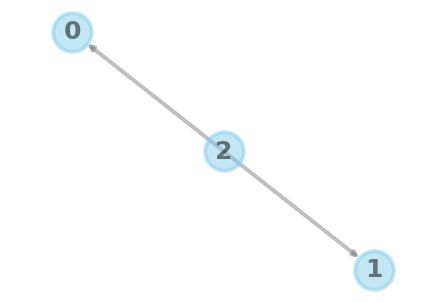

data shape: (52, 2)
CAUSATION MATRIX


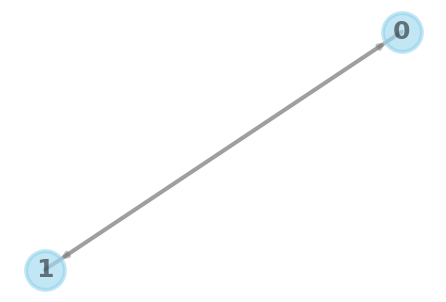

data shape: (52, 2)
CAUSATION MATRIX


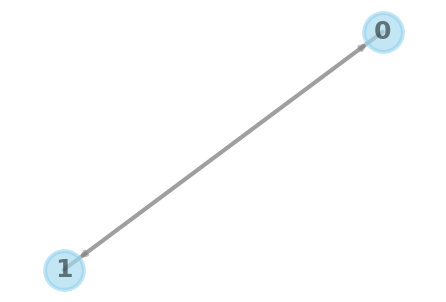

data shape: (52, 2)
CAUSATION MATRIX


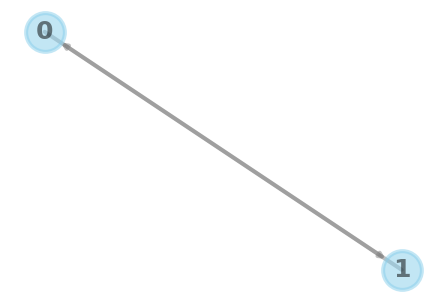

data shape: (52, 2)
CAUSATION MATRIX


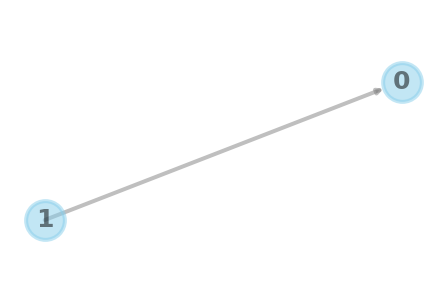

data shape: (52, 2)
CAUSATION MATRIX


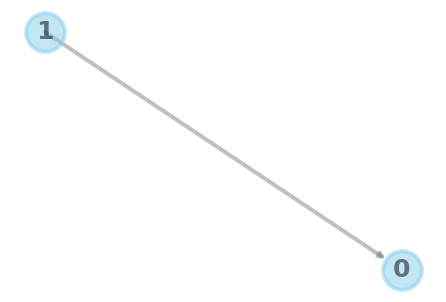

data shape: (52, 2)
CAUSATION MATRIX


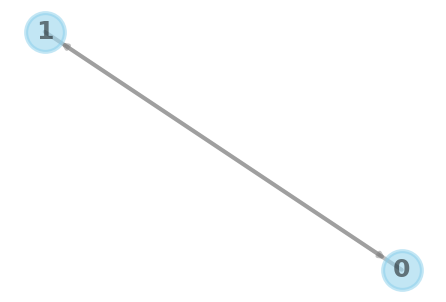

data shape: (52, 3)
CAUSATION MATRIX


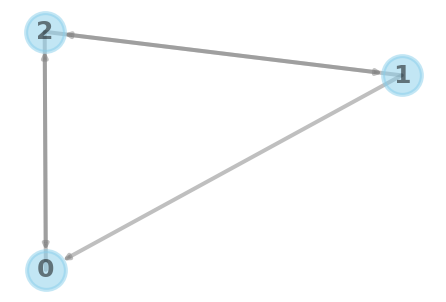

data shape: (52, 3)
CAUSATION MATRIX


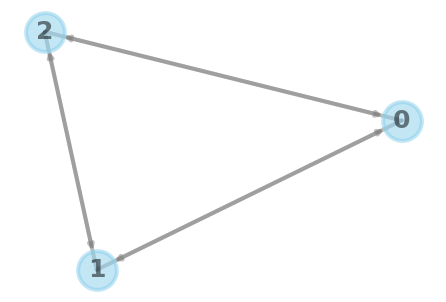

data shape: (52, 3)
CAUSATION MATRIX


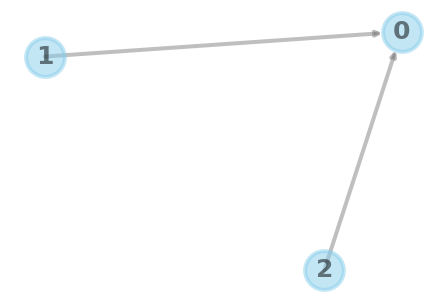

data shape: (52, 3)
CAUSATION MATRIX


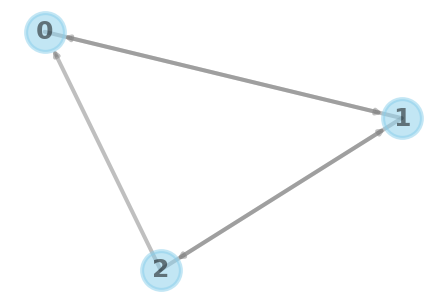

data shape: (52, 3)
CAUSATION MATRIX


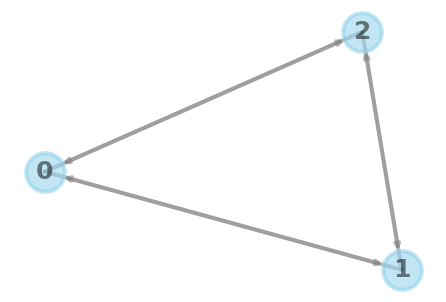

data shape: (52, 4)
CAUSATION MATRIX


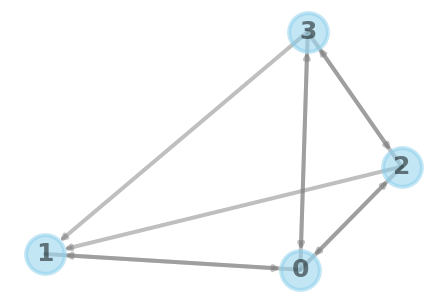

data shape: (52, 3)
CAUSATION MATRIX


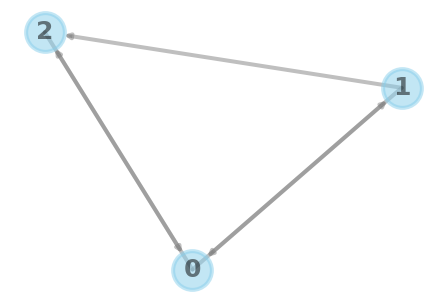

data shape: (52, 2)
CAUSATION MATRIX


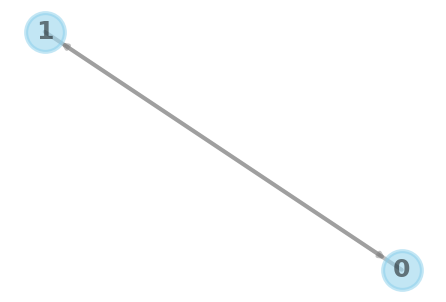

data shape: (52, 3)
CAUSATION MATRIX


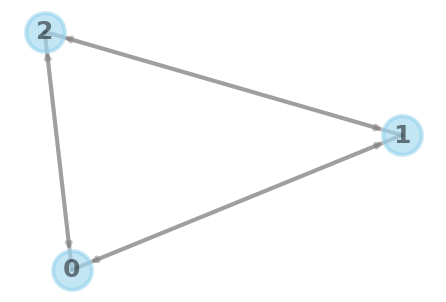

data shape: (52, 3)
CAUSATION MATRIX


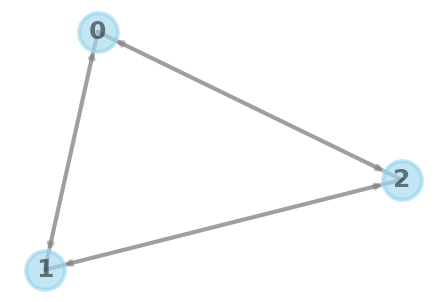

data shape: (52, 3)
CAUSATION MATRIX


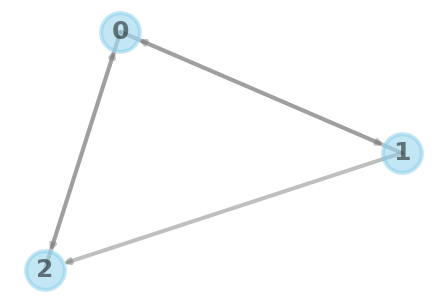

data shape: (52, 2)
CAUSATION MATRIX


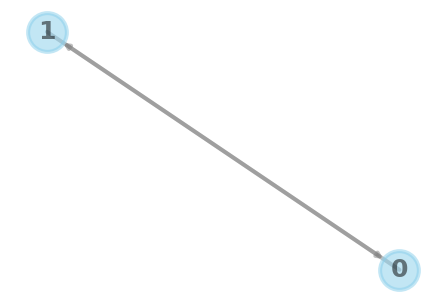

data shape: (52, 3)
CAUSATION MATRIX


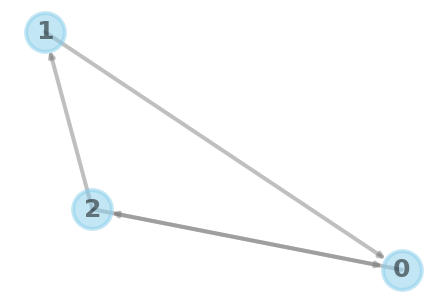

data shape: (52, 2)
CAUSATION MATRIX


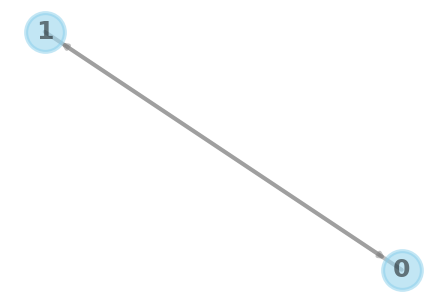

data shape: (52, 2)
CAUSATION MATRIX


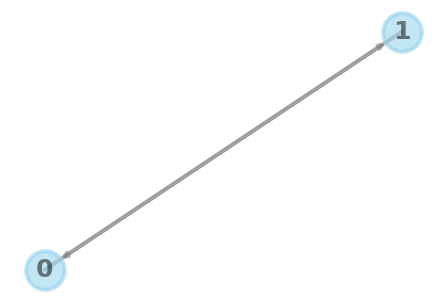

data shape: (52, 3)
CAUSATION MATRIX


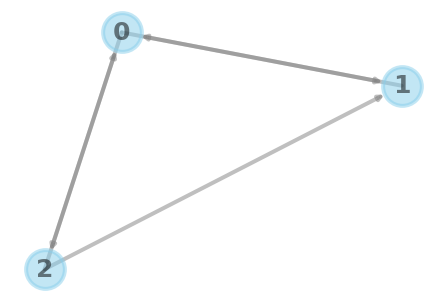

data shape: (52, 2)
CAUSATION MATRIX


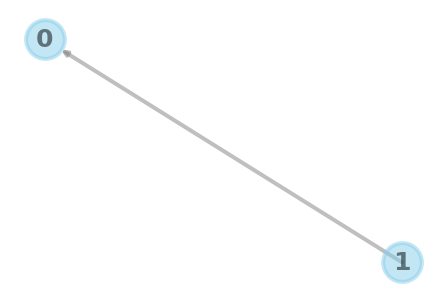

data shape: (52, 2)
CAUSATION MATRIX


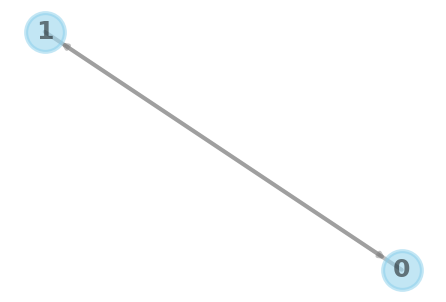

data shape: (52, 3)
CAUSATION MATRIX


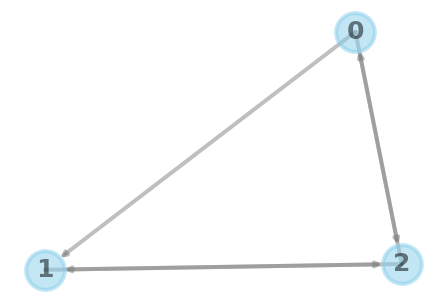

data shape: (52, 1)
CAUSATION MATRIX


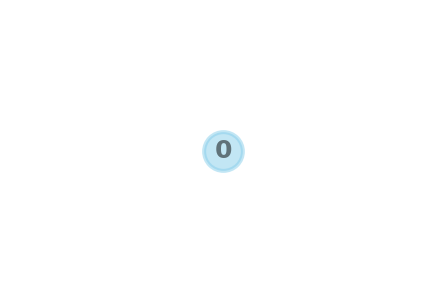

data shape: (52, 2)
CAUSATION MATRIX


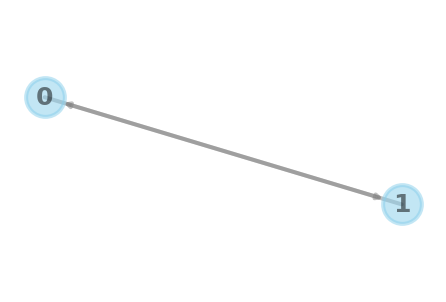

data shape: (52, 1)
CAUSATION MATRIX


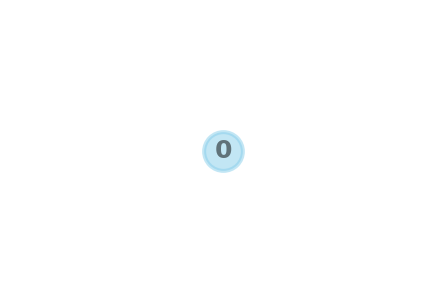

data shape: (52, 3)
CAUSATION MATRIX


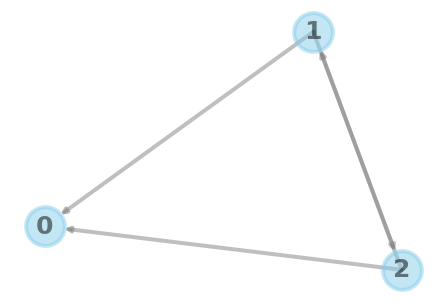

data shape: (52, 3)
CAUSATION MATRIX


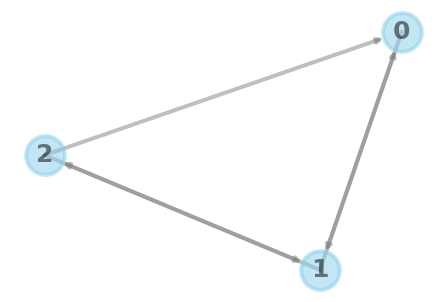

data shape: (52, 4)
CAUSATION MATRIX


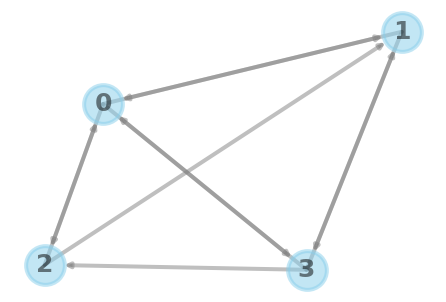

data shape: (52, 2)
CAUSATION MATRIX


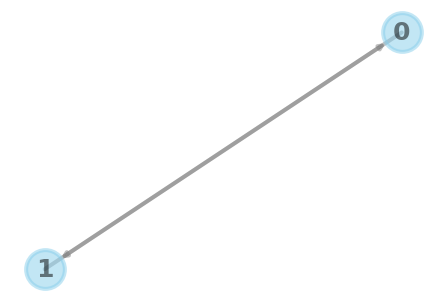

data shape: (52, 1)
CAUSATION MATRIX


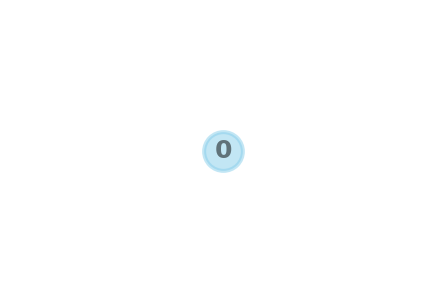

data shape: (52, 2)
CAUSATION MATRIX


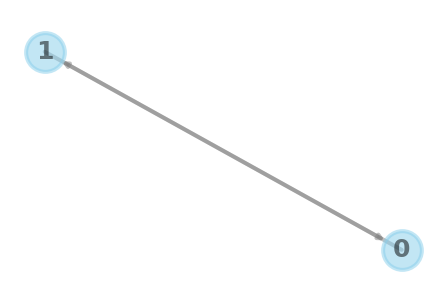

data shape: (52, 2)
CAUSATION MATRIX


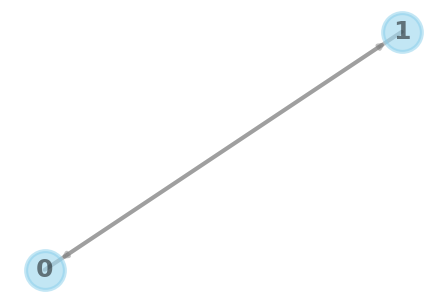

data shape: (52, 2)
CAUSATION MATRIX


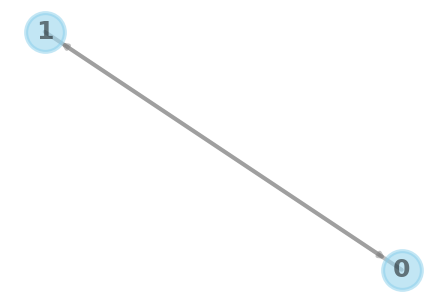

data shape: (52, 2)
CAUSATION MATRIX


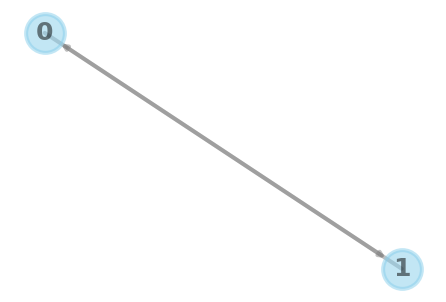

data shape: (52, 2)
CAUSATION MATRIX


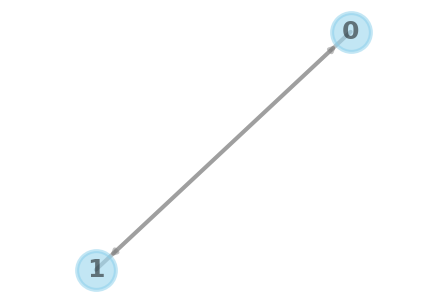

data shape: (52, 2)
CAUSATION MATRIX


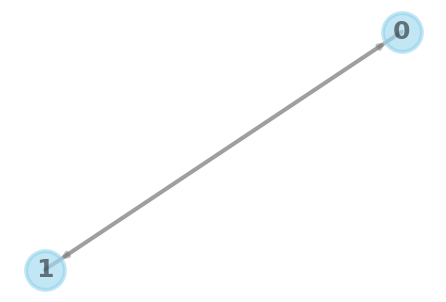

data shape: (52, 3)
CAUSATION MATRIX


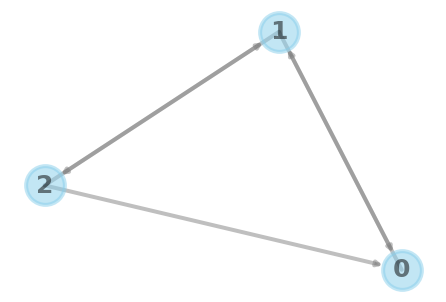

data shape: (52, 1)
CAUSATION MATRIX


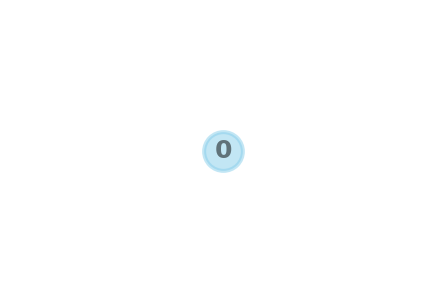

data shape: (52, 3)
CAUSATION MATRIX


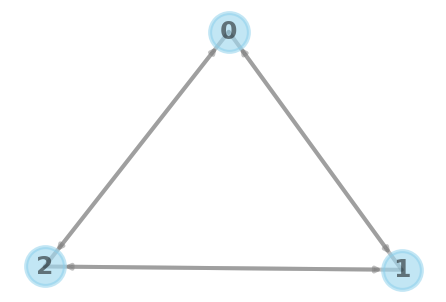

data shape: (52, 3)
CAUSATION MATRIX


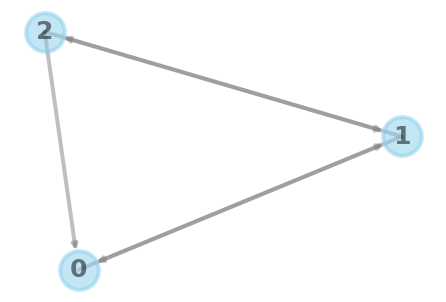

data shape: (52, 2)
CAUSATION MATRIX


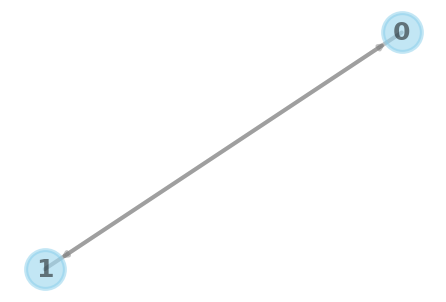

data shape: (52, 3)
CAUSATION MATRIX


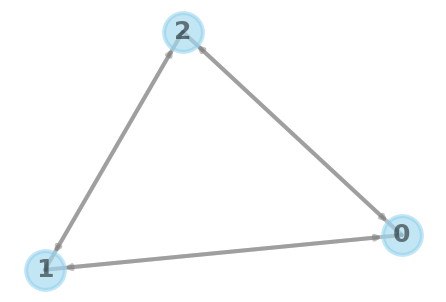

data shape: (52, 2)
CAUSATION MATRIX


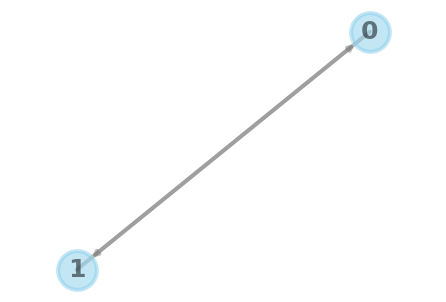

data shape: (52, 2)
CAUSATION MATRIX


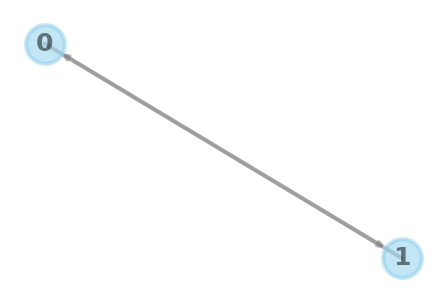

data shape: (52, 2)
CAUSATION MATRIX


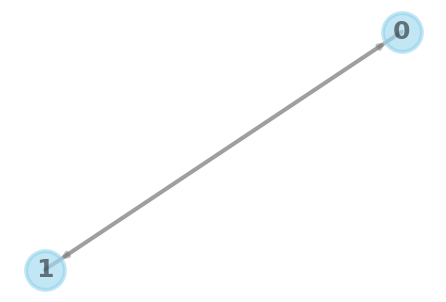

data shape: (52, 2)
CAUSATION MATRIX


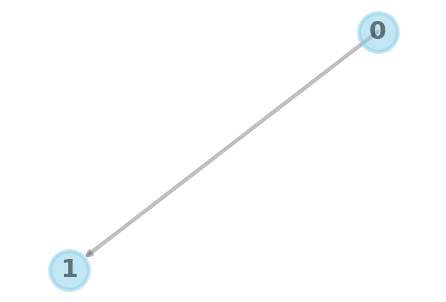

data shape: (52, 1)
CAUSATION MATRIX


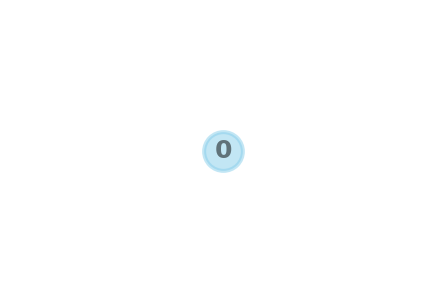

In [40]:
for i in range(num0):
    orig=b0[clustering0.labels_==i]
    dati=pd.DataFrame(orig).T
    print('data shape:',dati.shape)
    from statsmodels.tsa.stattools import grangercausalitytests
    maxlag=12
    def granger_causation_matrix(data, variables, verbose=False):
        X_train=pd.DataFrame(np.zeros((len(variables), len(variables))), columns=variables, index=variables)
        for c in X_train.columns:
            for r in X_train.index:
                test_result=grangercausalitytests(data[[r,c]], maxlag=maxlag, verbose=False)
                p_values=[round(test_result[i+1][0]['ssr_chi2test'][1],4) for i in range(maxlag)]
                min_p_value=np.min(p_values)
                X_train.loc[r,c]=min_p_value
        X_train.columns=[var for var in variables]
        X_train.index=[var  for var in variables]
        return X_train
    print('CAUSATION MATRIX')

    import networkx as nx
    M=np.array(granger_causation_matrix(dati, variables=dati.columns))
    M=1-M
    M[M<0.95]=0
    M=M.T


    G=nx.DiGraph(M)
    nx.draw(G,with_labels=True,arrows=True, node_size=1500, node_color="skyblue", node_shape="o", alpha=0.5, linewidths=4, font_size=25, font_color="black", font_weight="bold", width=4, edge_color="grey")
    plt.show()

### Group 1

For what concerns group 1 only one cluster has only one disconnected node and there are 9 clusters are composed of one single time series

### Group 2

For what concerns group 2 all the time series in all clusters are linked with some causal relationship

data shape: (52, 23)
CAUSATION MATRIX


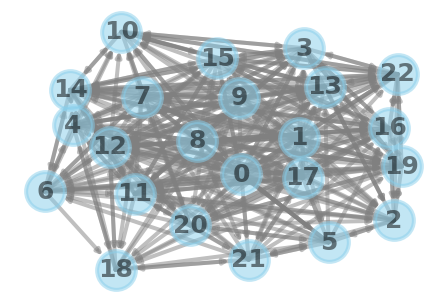

data shape: (52, 4)
CAUSATION MATRIX


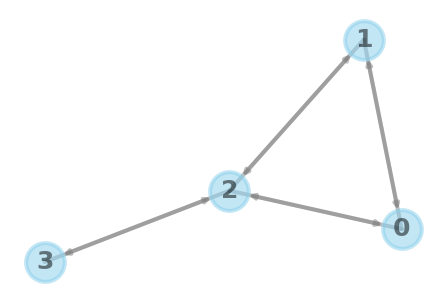

data shape: (52, 11)
CAUSATION MATRIX


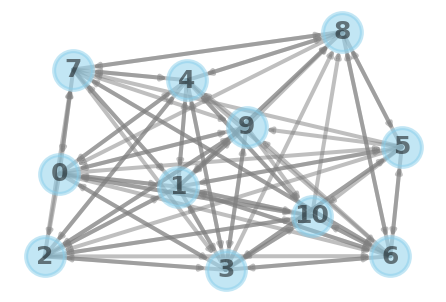

data shape: (52, 13)
CAUSATION MATRIX


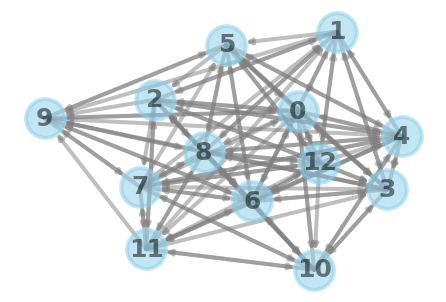

data shape: (52, 10)
CAUSATION MATRIX


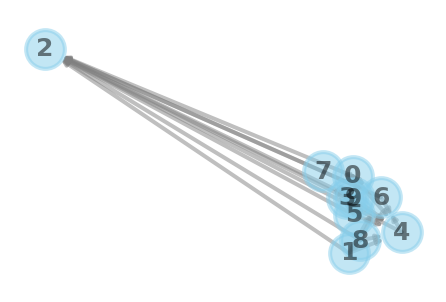

data shape: (52, 8)
CAUSATION MATRIX


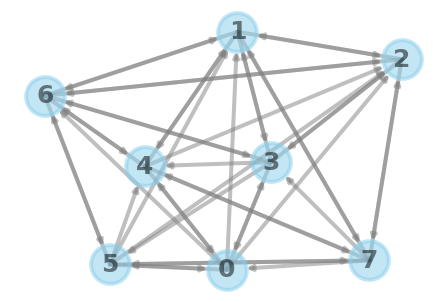

data shape: (52, 10)
CAUSATION MATRIX


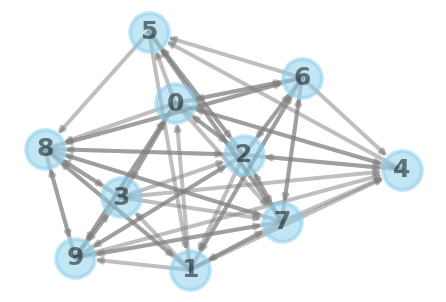

data shape: (52, 10)
CAUSATION MATRIX


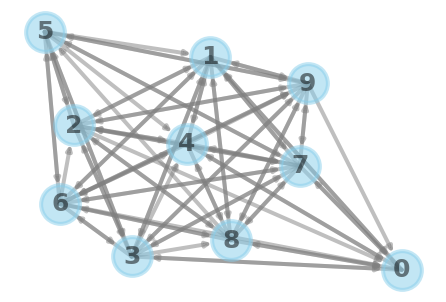

In [37]:
for i in range(num2):
    orig=b2[clustering2.labels_==i]
    dati=pd.DataFrame(orig).T
    print('data shape:',dati.shape)
    from statsmodels.tsa.stattools import grangercausalitytests
    maxlag=12
    def granger_causation_matrix(data, variables, verbose=False):
        X_train=pd.DataFrame(np.zeros((len(variables), len(variables))), columns=variables, index=variables)
        for c in X_train.columns:
            for r in X_train.index:
                test_result=grangercausalitytests(data[[r,c]], maxlag=maxlag, verbose=False)
                p_values=[round(test_result[i+1][0]['ssr_chi2test'][1],4) for i in range(maxlag)]
                min_p_value=np.min(p_values)
                X_train.loc[r,c]=min_p_value
        X_train.columns=[var for var in variables]
        X_train.index=[var  for var in variables]
        return X_train
    print('CAUSATION MATRIX')

    import networkx as nx
    M=np.array(granger_causation_matrix(dati, variables=dati.columns))
    M=1-M
    M[M<0.95]=0
    M=M.T


    G=nx.DiGraph(M)
    nx.draw(G,with_labels=True,arrows=True, node_size=1500, node_color="skyblue", node_shape="o", alpha=0.5, linewidths=4, font_size=25, font_color="black", font_weight="bold", width=4, edge_color="grey")
    plt.show()

# [FORECASTING](#home)<a id='forecasts'></a> 

It was decided to random select a cluster among the group 0 clusters, the ones with more variability of numbers. Then, the time series inside are analyzed, plotting the autocorrelations, checking stationarity and if causality holds between them.


Then, the model is selected. Three different models were used: VAR, VECM and also VARMAX.

### Train-Test split

They are splitted in train and test, 47 weeks for training and 5 weeks for testing

In [41]:
orig=b0[clustering0.labels_==45]
train=orig[:,:47]
test=orig[:,47:]
dati=pd.DataFrame(orig).T
traindata=pd.DataFrame(train).T
print('data shape:',dati.shape)
print('train data shape:',traindata.shape)

data shape: (52, 5)
train data shape: (47, 5)


### Causality matrix

In [24]:
from statsmodels.tsa.stattools import grangercausalitytests
maxlag=12
def granger_causation_matrix(data, variables, verbose=False):
    X_train=pd.DataFrame(np.zeros((len(variables), len(variables))), columns=variables, index=variables)
    for c in X_train.columns:
        for r in X_train.index:
            test_result=grangercausalitytests(data[[r,c]], maxlag=maxlag, verbose=False)
            p_values=[round(test_result[i+1][0]['ssr_chi2test'][1],4) for i in range(maxlag)]
            min_p_value=np.min(p_values)
            X_train.loc[r,c]=min_p_value
    X_train.columns=[var for var in variables]
    X_train.index=[var  for var in variables]
    return X_train
print('CAUSATION MATRIX')
granger_causation_matrix(dati, variables=dati.columns)

CAUSATION MATRIX


,0,1,2,3,4
0,1.0000,0.0000,0.0,0.0005,0.0000
1,0.0000,1.0000,0.0,0.0428,0.0003
2,0.0000,0.0026,1.0,0.0000,0.0018
3,0.0673,0.0154,0.0,1.0000,0.0002
4,0.0996,0.1199,0.0,0.0015,1.0000


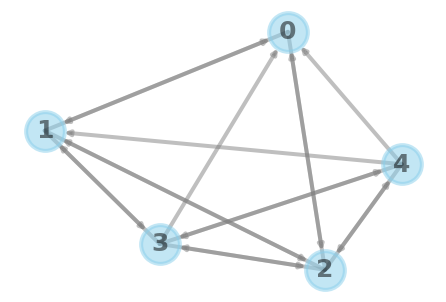

In [25]:
import networkx as nx
M=np.array(granger_causation_matrix(dati, variables=dati.columns))
M=1-M
M[M<0.95]=0
M=M.T


G=nx.DiGraph(M)
nx.draw(G,with_labels=True,arrows=True, node_size=1500, node_color="skyblue", node_shape="o", alpha=0.5, linewidths=4, font_size=25, font_color="black", font_weight="bold", width=4, edge_color="grey")
plt.show()

### Stationarity check

In [23]:
from statsmodels.tsa.stattools import adfuller
print('Series  ', 'p-value                ', 'Stationarity')
for i in range(num):
    print(i,'     ', adfuller(traindata[i])[1],'    ', adfuller(traindata[i])[1]<0.05)
#for i in range(num):
 #print('p-value transformed',adfuller(transform_data[i])[1])


Series   p-value                 Stationarity
0       3.820168837543005e-07      True
1       0.0016146819552590162      True
2       2.9864325351555315e-05      True
3       0.0005898212697371443      True
4       3.2938404573923905e-05      True


In [0]:
#transform_data=dati.diff().dropna()
#transform_data=dati #since dati are already good

## VAR

### Model selection (lag order)

The selection of the best model (the best lag order) is performed using 2 different methods. The first rely on the classical criteria AIC, BIC, FPE and HQIC. The most important one for our purposes is AIC. The second method considers the test set: RMSE, MAPE are computed using the forecast predicted by each model. Also the DTW distance is computed.

#### With criteria

In [25]:
import statsmodels.tsa.api as smt
from statsmodels.tsa.api import VAR
from statsmodels.tsa.vector_ar.vecm import VECM
mod = smt.VAR(traindata)
#mod.select_order(6).selected_orders
x = mod.select_order(maxlags=7)
x.summary()


,AIC,BIC,FPE,HQIC
0,15.71,15.92,6.655e+06,15.79
1,15.97,17.23,8.681e+06,16.42
2,16.48,18.80,1.546e+07,17.32
3,16.93,20.31,2.864e+07,18.15
4,16.98,21.42,4.245e+07,18.58
5,15.70,21.19,2.296e+07,17.68
6,14.24,20.78,2.012e+07,16.61
7,-26.86*,-19.26*,6.625e-10*,-24.11*


#### With errors

In [26]:
maxmape=np.inf
maxrmse=np.inf
maxdistance=np.inf
bestmape=0
bestrmse=0
bestdistance=0
for i in range(12):
    lag_order=i+1
    res = mod.fit(lag_order)
    pred=res.forecast(traindata.values[-lag_order:],5)
    conc=np.concatenate((train.T, pred), axis=0)
    conct=conc.T

  
    mape = np.mean(np.abs(conct - orig)/np.abs(orig), axis=1)
    rmse=(np.mean((conct-orig)**2, axis=1))**.5

    distance=0
    for j in range(conc.shape[1]):
        distance += dtw.distance(conct[j], orig[j])/conc.shape[1]

    if np.mean(mape)<maxmape:
        maxmape=np.mean(mape)
        bestmape=lag_order
    if np.mean(rmse)<maxrmse:
        maxrmse=np.mean(rmse)
        bestrmse=lag_order
    if distance<maxdistance:
        maxdistance=distance
        bestdistance=lag_order

    print('lag order', i+1)
    print('mape:',np.mean(mape))
    print('rmse:',np.mean(rmse))
    print('distance', distance)
print('\nbest mape result:',bestmape)
print('best rmse result:', bestrmse)
print('best distance result:', bestdistance)

lag order 1
mape: 0.023928275579703118
rmse: 3.1375639733296863
distance 22.41868436718223
lag order 2
mape: 0.02340827362497217
rmse: 3.1275228271822986
distance 22.35101245562224
lag order 3
mape: 0.020953814017424917
rmse: 2.809834353375467
distance 20.094459219206403
lag order 4
mape: 0.02428634050378508
rmse: 3.1187016856950853
distance 21.922848225695716
lag order 5
mape: 0.026098212759114326
rmse: 3.35606981203617
distance 23.079316496720512
lag order 6
mape: 0.02831340852139188
rmse: 3.454877629324188
distance 22.52821921143259
lag order 7
mape: 0.02489549235176076
rmse: 3.1757624819554855
distance 18.478878701917914
lag order 8
mape: 0.9358377096144453
rmse: 109.45555382612709
distance 784.5393381057852
lag order 9
mape: 0.06880371839241925
rmse: 6.817954077617043
distance 35.59361195921661
lag order 10
mape: 0.05283914258289161
rmse: 5.549749139094127
distance 31.978688172738515
lag order 11
mape: 0.05122767740334522
rmse: 5.432245278905006
distance 33.781329493310224
lag ord

This two method return different results. The classical criteria prefer lag order = 7, while classical errors prefer lag order = 3. DTW distance instead prefers again 7. A theoretical interpretation of these lags is not given because the type of products was not provided.

First we are going to try with 7 and then with 3. Further analysis (like cointegration or whitness of residuals) could be implemented using 3 whereas with 7 was not possible due to some computation problems.

## Lag order = 7

In [39]:
lag_order=7 
res = mod.fit(lag_order)
#print(res.summary())



pred=res.forecast(traindata.values[-lag_order:],5)
interv=res.forecast_interval(traindata.values[-lag_order:],5)
conc=np.concatenate((train.T, pred), axis=0)
conc_d=np.concatenate((train.T, interv[1]), axis=0)
conc_u=np.concatenate((train.T, interv[2]), axis=0)
conct=conc.T

mape = np.mean(np.abs(conct - orig)/np.abs(orig), axis=1)
rmse=(np.mean((conct-orig)**2, axis=1))**.5
print('lag order', lag_order)
print('mape:',np.mean(mape))
print('rmse:',np.mean(rmse))

distance=0
for j in range(conc.shape[1]):
    distance += dtw.distance(conct[j], orig[j])/conc.shape[1]
print('average distance:',distance)

lag order 7
mape: 0.02489549235176076
rmse: 3.1757624819554855
average distance: 18.478878701917914


### Durbin-Watson test

In [40]:
from statsmodels.stats.stattools import durbin_watson
out=durbin_watson(res.resid)

for col, val in zip(dati.columns, out):
    print(col, ':', round(val,2))

0 : 2.44
1 : 1.82
2 : 2.11
3 : 2.13
4 : 2.0


### Forecast

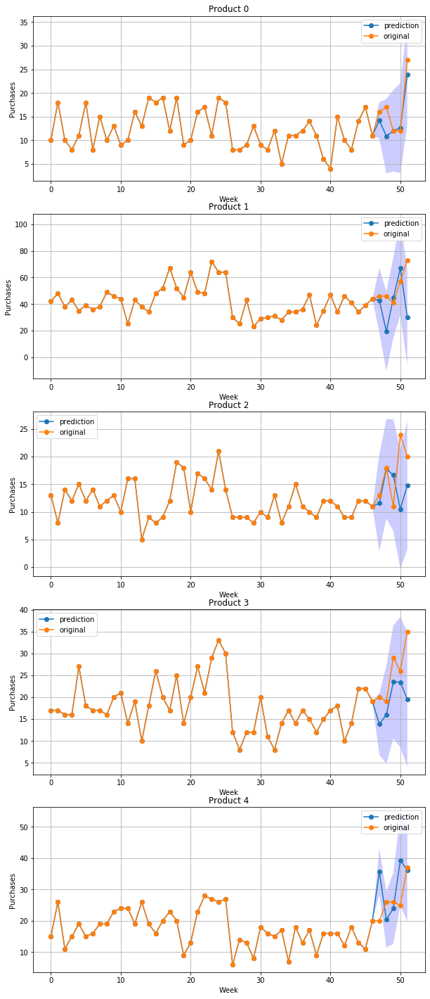

In [41]:
num=dati.shape[1]
fig, axs = plt.subplots(num, 1, figsize=(10,num*5))
axs = axs.ravel()
for i in range(num):
    axs[i].set_xlabel('Week')
    axs[i].set_ylabel('Purchases')
    axs[i].set_title('Product %d'%(i))
    axs[i].plot(np.arange(52),conc[:,i], '-o', label='prediction')
    axs[i].fill_between(np.arange(52), conc_u[:,i], conc_d[:,i], where=conc_u[:,i] >= conc_d[:,i], facecolor='blue', interpolate=True, alpha=0.2)
    axs[i].plot(np.arange(52),orig[i], '-o', label='original')
    axs[i].legend()
    axs[i].grid()

## Lag order = 3

### Normality checks

In [31]:
lag_order=3 
res = mod.fit(lag_order)
#print(res.summary())



pred=res.forecast(traindata.values[-lag_order:],5)
interv=res.forecast_interval(traindata.values[-lag_order:],5)
conc=np.concatenate((train.T, pred), axis=0)
conc_d=np.concatenate((train.T, interv[1]), axis=0)
conc_u=np.concatenate((train.T, interv[2]), axis=0)
conct=conc.T

mape = np.mean(np.abs(conct - orig)/np.abs(orig), axis=1)
rmse=(np.mean((conct-orig)**2, axis=1))**.5
print('lag order', lag_order)
print('mape:',np.mean(mape))
print('rmse:',np.mean(rmse))
distance=0
for j in range(conc.shape[1]):
    distance += dtw.distance(conct[j], orig[j])/conc.shape[1]
print('average distance:',distance,'\n')

if (lag_order!=7):
    test_norm=res.test_normality()
    print(test_norm.summary())
    test_white=res.test_whiteness()
    print(test_white.summary())

lag order 3
mape: 0.020953814017424917
rmse: 2.809834353375467
average distance: 20.094459219206403 

normality (skew and kurtosis) test. H_0: data generated by normally-distributed process. Conclusion: fail to reject H_0 at 5% significance level.
Test statistic Critical value p-value df
----------------------------------------
         4.768          18.31   0.906 10
----------------------------------------
Portmanteau-test for residual autocorrelation. H_0: residual autocorrelation up to lag 10 is zero. Conclusion: fail to reject H_0 at 5% significance level.
Test statistic Critical value p-value  df
-----------------------------------------
         175.8          206.9   0.469 175
-----------------------------------------


### Durbin-Watson test

In [0]:
from statsmodels.stats.stattools import durbin_watson
out=durbin_watson(res.resid)

for col, val in zip(dati.columns, out):
    print(col, ':', round(val,2))

0 : 1.92
1 : 1.97
2 : 2.17
3 : 2.07
4 : 2.08


### Cointegration test

In [0]:
from statsmodels.tsa.vector_ar.vecm import coint_johansen
def cointegration_test(transform_data, alpha=0.05):
    out=coint_johansen(transform_data, -1, lag_order)
    d={'0.9':0, '0.95':1, '0.99':2}
    traces=out.lr1
    cvts=out.cvt[:,d[str(1-alpha)]]
    def adjust(val, length=6): return str(val).ljust(length)

    print('# coint vec   :: Test stat > C(95%)   ->  signif \n', '--'*20)
    for col, trace, cvt in zip(transform_data.columns, traces, cvts):
        print(adjust(col), '::', adjust(round(trace,2),9), '>', adjust(cvt, 8), '->', trace>cvt)

cointegration_test(traindata)
#cointegration_test(transform_data)

# coint vec   :: Test stat > C(95%)   ->  signif 
 ----------------------------------------
0      :: 82.39     > 60.0627  -> True
1      :: 47.54     > 40.1749  -> True
2      :: 20.62     > 24.2761  -> False
3      :: 9.91      > 12.3212  -> False
4      :: 0.02      > 4.1296   -> False


### Forecast

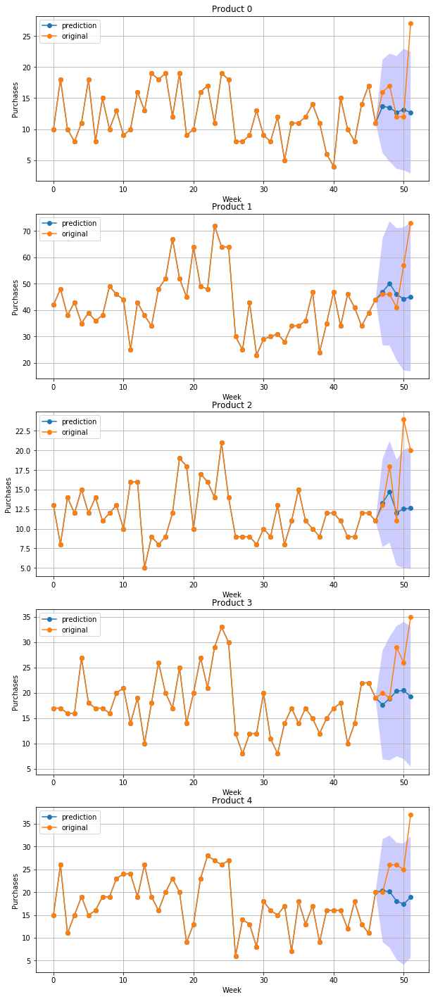

In [32]:
num=dati.shape[1]
fig, axs = plt.subplots(num, 1, figsize=(10,num*5))
axs = axs.ravel()
for i in range(num):
    axs[i].set_xlabel('Week')
    axs[i].set_ylabel('Purchases')
    axs[i].set_title('Product %d'%(i))
    axs[i].plot(np.arange(52),conc[:,i], '-o', label='prediction')
    axs[i].fill_between(np.arange(52), conc_u[:,i], conc_d[:,i], where=conc_u[:,i] >= conc_d[:,i], facecolor='blue', interpolate=True, alpha=0.2)
    axs[i].plot(np.arange(52),orig[i], '-o', label='original')
    axs[i].legend()
    axs[i].grid()


# CONCLUSIONS

The first clustering is able to characterize different groups basing on a specific property of them. The second clustering instead in able to collect similar time series in the same clusters and to find the causal relationships between them.

VAR models outperform both VECM and VARMAX. But in which way should we choose between lag 3 and lag 7? 

The results, as already mention, are opposite. The errors prefer 3 but the distance and also the criteria prefer 7. Maybe knowing the origin of the data (i.e. the products) could be useful. Choosing the right model might become easier if some theoretical argument comes into play.